# BIOMED: Practical work 1 
## Medical image segmentation
### IMA M2 - Sorbonne Université 2024
### GRUSS Carlos, RCHAKI Oussama, ZOBOLI Niccoló

# Imports

In [1]:
# Standard library imports
import glob
import os
import sys

# Third-party imports
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from mpl_toolkits.axes_grid1 import AxesGrid

# Scipy imports
import scipy
from scipy import ndimage as ndi
from scipy.io import loadmat
from scipy.ndimage import distance_transform_edt
from scipy.spatial.distance import dice

# Skimage imports
import skimage
from skimage import io as skio
from skimage import img_as_float
from skimage.draw import line
from skimage.filters import threshold_otsu, threshold_multiotsu, gaussian
from skimage.io import imread
from skimage import measure
from skimage.measure import find_contours
import skimage.morphology as morpho
from skimage.segmentation import watershed, active_contour, chan_vese, checkerboard_level_set, disk_level_set
from skimage.transform import rescale

# Sklearn imports
import sklearn
from sklearn.cluster import KMeans

Requirements for Python and libraries are listed below:

In [2]:
# Print Python and library versions 
print('Python: {}'.format(sys.version))
print('Numpy: {}'.format(np.__version__))
print('Matplotlib: {}'.format(matplotlib.__version__))
print('Scikit-image: {}'.format(skimage.__version__))
print('Scipy: {}'.format(scipy.__version__))
print('Scikit-learn: {}'.format(sklearn.__version__))

Python: 3.12.3 | packaged by conda-forge | (main, Apr 15 2024, 18:20:11) [MSC v.1938 64 bit (AMD64)]
Numpy: 1.26.4
Matplotlib: 3.8.4
Scikit-image: 0.24.0
Scipy: 1.14.1
Scikit-learn: 1.5.2


# Auxiliary functions

In [3]:
def strel(forme, taille, angle=45):
    """renvoie un element structurant de forme  
     'diamond'  boule de la norme 1 fermee de rayon taille
     'disk'     boule de la norme 2 fermee de rayon taille
     'square'   carre de cote taille (il vaut mieux utiliser taille=impair)
     'line'     segment de langueur taille et d'orientation angle (entre 0 et 180 en degres)
      (Cette fonction n'est pas standard dans python)
    """

    if forme == 'diamond':
        return morpho.diamond(taille)
    if forme == 'disk':
        return morpho.disk(taille)
    if forme == 'square':
        return morpho.square(taille)
    if forme == 'line':
        angle = int(-np.round(angle))
        angle = angle % 180
        angle = np.float32(angle)/180.0*np.pi
        x = int(np.round(np.cos(angle)*taille))
        y = int(np.round(np.sin(angle)*taille))
        if x**2+y**2 == 0:
            if abs(np.cos(angle)) > abs(np.sin(angle)):
                x = int(np.sign(np.cos(angle)))
                y = 0
            else:
                y = int(np.sign(np.sin(angle)))
                x = 0
        rr, cc = line(0, 0, y, x)
        rr = rr-rr.min()
        cc = cc-cc.min()
        img = np.zeros((rr.max()+1, cc.max()+1))
        img[rr, cc] = 1
        return img
    raise RuntimeError('Erreur dans fonction strel: forme incomprise')

# Quantitative evaluation using Dice index (you can also use the dice function of scipy)
def Dice(segm, segm_ref):
    if segm.shape != segm_ref.shape:
        raise ValueError("Les deux images doivent avoir la meme taille.")
    segm = np.asarray(segm).astype(bool)
    segm_ref = np.asarray(segm_ref).astype(bool)
    intersection = np.logical_and(segm, segm_ref)
    dice = 2.0 * intersection.sum() / (segm.sum()+segm_ref.sum())
    return dice

# Visual comparison (segm can be a segmentation mask or its contour)
# you can also use the find_contours function
def ComparVisu(image, segm):
    return np.maximum(image, segm)

def Contour(segm):
    se = morpho.disk(1)
    contour = morpho.dilation(segm, se)-segm
    # or dilation - erosion to get a 2 pixels width contour (symmetric and more visible)
    return contour

def initialize_segmentation(seed_pt, img_shape):
    seg_init = np.zeros(img_shape).astype(float)
    seg_init[seed_pt[0], seed_pt[1]] = 1
    dist = distance_transform_edt(np.abs(1-seg_init))

    # initialise the seeded region with a certain radius
    size_radius = 5
    seg_init = dist < size_radius
    return seg_init

def segmentation_region_growing(img, tau, seed_pt=None, seg=None, mode='seed'):
    # define the neighbourhood (for instance 4-connected pixels)
    #se = strel('diamond', 1) # 4-conn
    # or 8-connected pixels
    se = strel('square', 3) # 8-conn

    if mode == 'seed' and seed_pt is not None:
        seg_init = initialize_segmentation(seed_pt, img.shape)
    elif mode == 'segmentation' and seg is not None:
        seg_init = seg
    else:
        raise ValueError("mode should be either 'seed' or 'segmentation'.")
    
    seg_n_plus_1 = seg_init
    seg_n = np.zeros(seg_n_plus_1.shape)

    # loop while the region can still keep growing
    while (np.abs(seg_n_plus_1 != seg_n).sum() != 0):
        seg_n = seg_n_plus_1
        seg_n_plus_1 = morpho.dilation(seg_n, se).astype(seg_n.dtype)
        # calculate average value
        avg = np.sum(img[seg_n > 0]) / (float(seg_n.sum()))
        seg_n_plus_1 = np.logical_and(seg_n_plus_1, np.abs(img-avg) < tau)
        # do not lose previous points of the segmentation
        seg_n_plus_1 = np.logical_or(seg_n_plus_1, seg_n)

    return seg_n, seg_init


In [4]:
if 'google.colab' in str(get_ipython()):
    from google_drive_downloader import GoogleDriveDownloader as gdd

    gdd.download_file_from_google_drive(file_id='1E-F5x83qaPRUrcdusfyOSgiZWf0pLDFl',
                                        dest_path='./abdominalCT.zip',
                                        unzip=True)

    gdd.download_file_from_google_drive(file_id='1UTSW2nGWV8SBE_ILZQkM-jQvnfoQKDlm',
                                        dest_path='./brainMRI.zip',
                                        unzip=True)

    gdd.download_file_from_google_drive(file_id='1BZtShVk7LVG032GOlcLs0K4Eaj6gnBed',
                                        dest_path='./MRIheart.zip',
                                        unzip=True)

    gdd.download_file_from_google_drive(file_id='1BoU4S9xFgKaCtquU03kZQbH3Yv42oU_-',
                                        dest_path='./skinlesion.zip',
                                        unzip=True)
else:
    print('You are not using Colab. Please define working_dir with the absolute path to the folder where you downloaded the data')

# Please modify working_dir only if you are using your Anaconda (and not Google Colab)
# You should write the absolute path of your working directory with the data
Working_directory = "./dataTPseg/"

You are not using Colab. Please define working_dir with the absolute path to the folder where you downloaded the data


# Thresholding


- Compare the histograms of images of the same modality. Are the conclusions the same on CT images and on MRI images?
- Consequences on manual thresholding?
- Test the automatic Otsu's thresholding method. Conclusions?
- Test the automatic k-means method (2 classes or more). Conclusions?


## Histogram analysis

### Abdominal CT

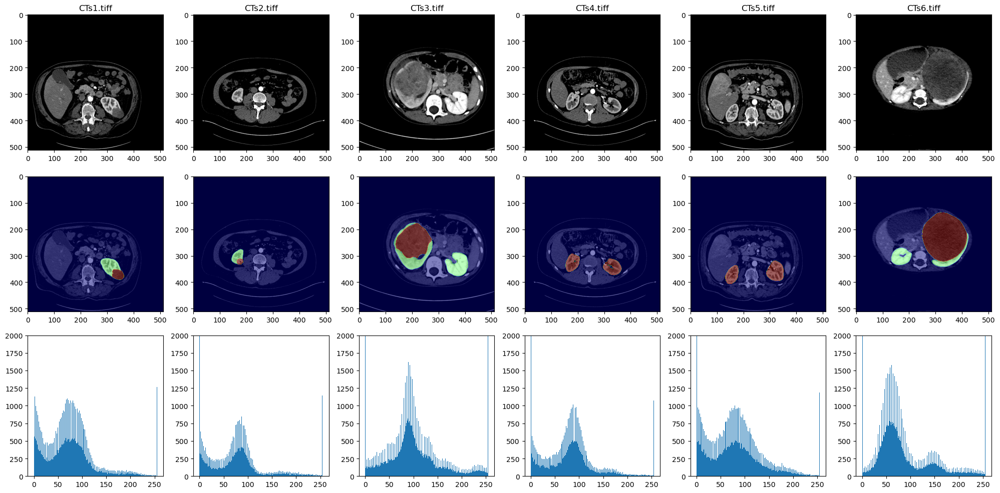

In [5]:
file_path = Working_directory + 'abdominalCT'
list_images = glob.glob(file_path + '/*-seg.tiff')

plt.figure(figsize=(20, 10))
for i in range(len(list_images)):
    filename = list_images[i]
    im_Seg = imread(filename)
    filename = filename[:-9] + '.tiff'
    imG = imread(filename)

    plt.subplot(3, len(list_images), i+1)
    plt.imshow(imG, cmap='gray')
    plt.title(f'{filename.split("\\")[-1]}')
    #plt.title(f'{os.path.basename(filename_original)}') if working with windows

    plt.subplot(3, len(list_images), i+1+len(list_images))
    plt.imshow(imG, cmap='gray')
    plt.imshow(im_Seg, cmap='jet', alpha=0.5)

    # Compute the histogram of the image
    # Exclude 0 from the histogram since it is the background
    plt.subplot(3, len(list_images), i+1+2*len(list_images))
    plt.hist(imG.ravel(), bins=256, range=(0, 255))
    plt.ylim((0, 2000))
    

plt.tight_layout()
plt.show()

In the previous figure, we compute the histogram for various Abdominal CT images. For visualization purposes, we've set the vertical limit of the plot to 2000, since the histograms have large peaks at certain bins (such as zero for the background).

We observe that the histograms are quite similar across all CT images, with a large peak at zero, another between 50 and 100, and a very small one around the 150-200 range. 

### Brain MRI

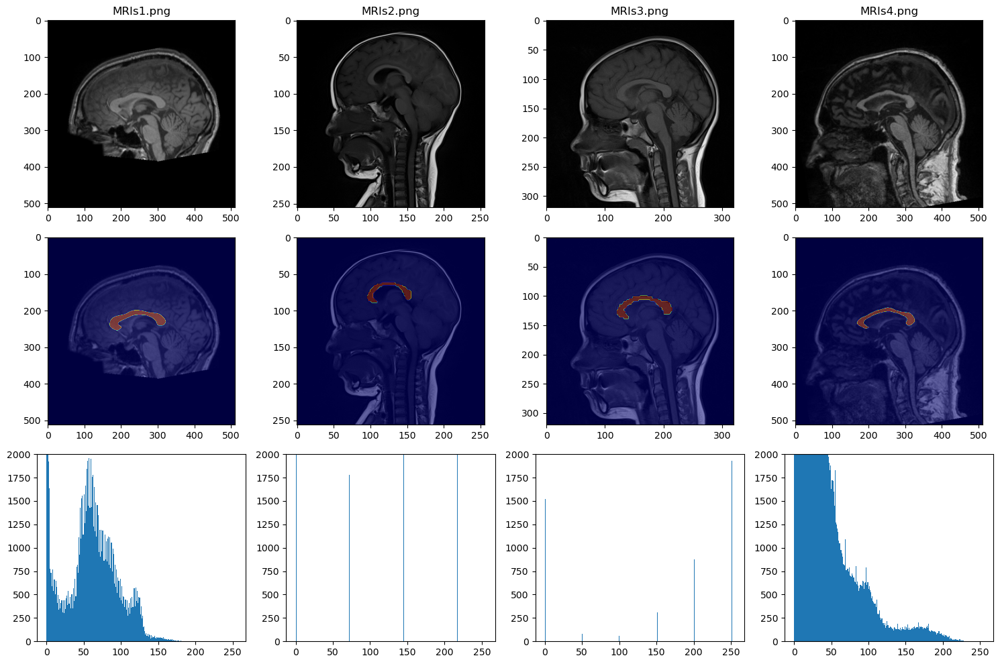

In [6]:
# Repeat the previous cell but for the brain MRI images
file_path = Working_directory + 'brainMRI'
list_images = glob.glob(file_path + '/*-seg.png')

plt.figure(figsize=(15, 10))
for i in range(len(list_images)):
    filename = list_images[i]
    im_Seg = imread(filename)
    filename = filename[:-8] + '.png'
    imG = imread(filename)

    plt.subplot(3, len(list_images), i+1)
    plt.imshow(imG, cmap='gray')
    plt.title(f'{filename.split("\\")[-1]}')
    #plt.title(f'{os.path.basename(filename_original)}') if working with windows

    plt.subplot(3, len(list_images), i+1+len(list_images))
    plt.imshow(imG, cmap='gray')
    plt.imshow(im_Seg, cmap='jet', alpha=0.5)

    # Compute the histogram of the image
    plt.subplot(3, len(list_images), i+1+2*len(list_images))
    plt.hist(imG.ravel(), bins=256, range=(0, 255))
    plt.ylim((0, 2000))

plt.tight_layout()
plt.show()

In the previous figure we plot the histograms for Brain MRI images. For visualization purposes, we've set the vertical limit of the plot to 2000, since the histograms have large peaks at certain bins (such as zero for the background). 

We notice much more variability in this set of images than in the Abdominal CT images, and also a lot of intra-set variability. This foreshadows that thresholding might not be the best way to segment these images.

### Skin lesions

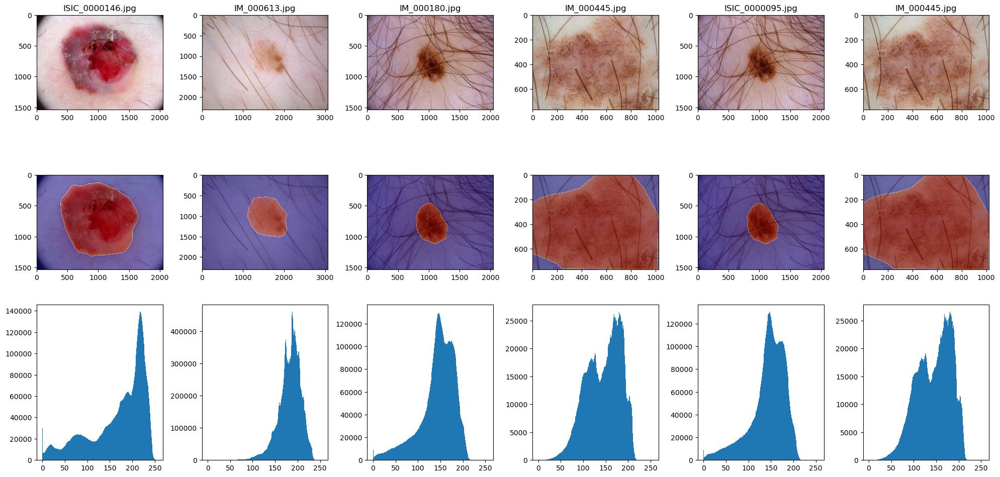

In [7]:
# Repeat the previous cell but for the skin lesion images
file_path = Working_directory + 'skinlesion'
list_images = glob.glob(file_path + '/*_Segmentation.png')

# Select a random subsample of list_images
np.random.seed(0)
list_images = np.random.choice(list_images, 6)

plt.figure(figsize=(20, 10))

for i in range(len(list_images)):
    filename = list_images[i]
    im_Seg = imread(filename)
    filename = filename[:-17] + '.jpg'
    imG = imread(filename)

    plt.subplot(3, len(list_images), i+1)
    plt.imshow(imG, cmap='gray')
    plt.title(f'{filename.split("\\")[-1]}')
    #plt.title(f'{os.path.basename(filename_original)}') if working with windows

    plt.subplot(3, len(list_images), i+1+len(list_images))
    plt.imshow(imG, cmap='gray')
    plt.imshow(im_Seg, cmap='jet', alpha=0.5)

    # Compute the histogram of the image
    plt.subplot(3, len(list_images), i+1+2*len(list_images))
    plt.hist(imG.ravel(), bins=256, range=(0, 255))
    #plt.ylim((0, 2000))

plt.tight_layout()
plt.show()

In the previous figure we have the histograms for the Skin Lesion images. We notice they are much softer than for the other modalities, since the images are of higher resolution. We also observe they are quite similar between themselves, even though the dataset contains quite a bit of variability. This hints to us that segmentation by thresholding could work well on these images.

### MRI heart

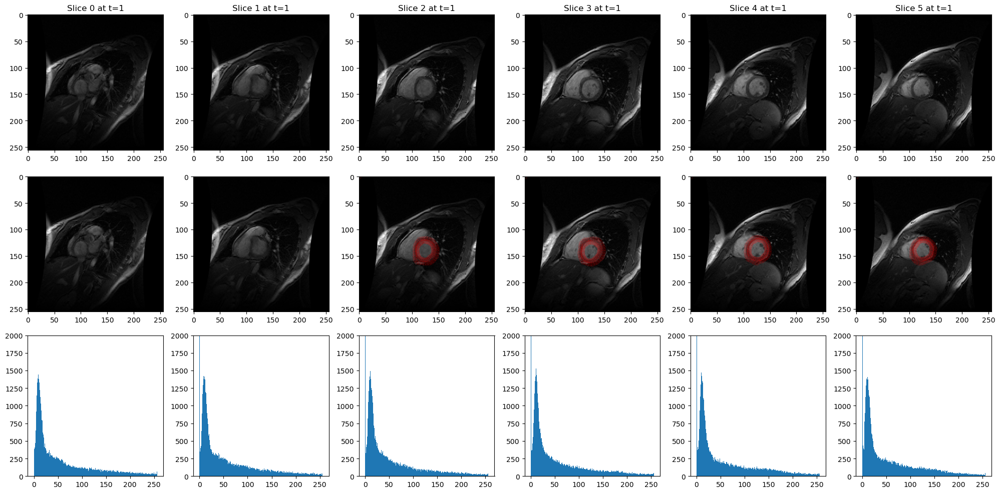

In [8]:
MRIheart_path = Working_directory + 'MRIheart/'
data = loadmat(MRIheart_path + 'dataMRIheart.mat')
data = data['data']
seg = loadmat(MRIheart_path + 'segMRIheart.mat')
seg = seg['seg']

# Select a time between 0 and 19
TIMEFRAME = 1

fig, ax = plt.subplots(3, 6)

# Set figsize
fig.set_figheight(10)
fig.set_figwidth(20)

# Plot image, segmentation and histogram
for i in range(6):
    # Image
    ax[0, i].imshow(data[:, :, i, TIMEFRAME], cmap='gray')
    ax[0, i].set_title(f'Slice {i} at t={TIMEFRAME}')

    # Segmentation
    ax[1, i].imshow(data[:, :, i, TIMEFRAME], cmap='gray')
    if len(seg[i, TIMEFRAME]) > 1:
        ax[1, i].scatter(seg[i, TIMEFRAME][:, 0], seg[i, TIMEFRAME][:, 1], c='r', alpha=0.1)
    
    # Histogram
    ax[2, i].hist(data[:, :, i, TIMEFRAME].ravel(), bins=256, range=(0, 256))
    ax[2, i].set_ylim((0, 2000))

plt.tight_layout()
plt.show()

Histograms for different z-axis slices at the same timeframe. We can set the time at which we want to observe the histograms with the parameter ``TIMEFRAME`` in the code block above. On the code block below, we perform the opposite, by selecting a slice with the parameter ``SLICENUM`` and plotting the histogram for different timeframes. In all cases we've limited the max y-value of the histogram for better visualization.

The observations on the histograms are pretty much the same regardless of the time frame and slice number, even in cases in which the ventricle is not visible in the image, the histogram for the slices is pretty much the same. This implies that we won't probably be able to find a good segmentation of these images by thresholding. Intuitively, this is probably because the structure we want to segment consists of a very small contour (the wall of the ventricle) which consists of a very small amount of pixels relative to the whole image, so it's unlikely we can extract the relevant information from the global histogram.

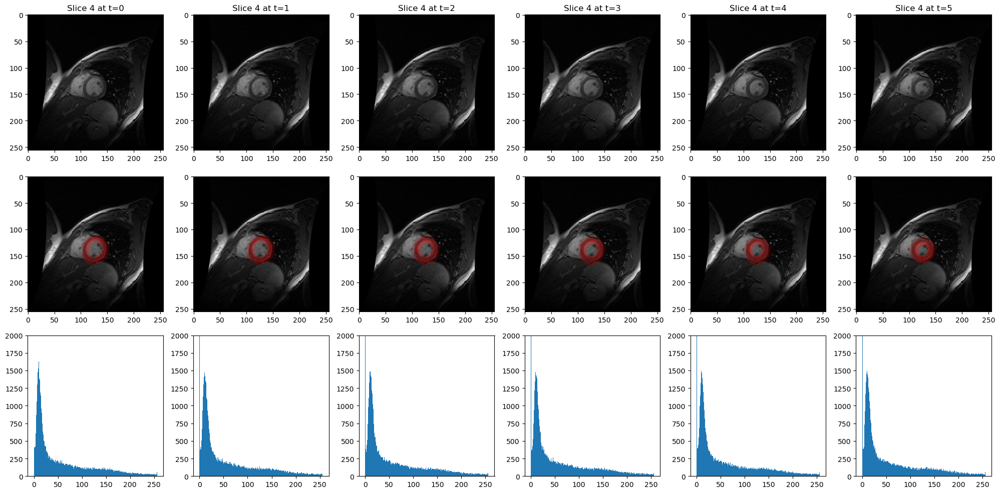

In [9]:
SLICENUM = 4

fig, ax = plt.subplots(3, 6)

# Set figsize
fig.set_figheight(10)
fig.set_figwidth(20)

# Plot image, segmentation and histogram
for i in range(6):
    # Image
    ax[0, i].imshow(data[:, :, SLICENUM, i], cmap='gray')
    ax[0, i].set_title(f'Slice 4 at t={i}')

    # Segmentation
    ax[1, i].imshow(data[:, :, SLICENUM, i], cmap='gray')
    if len(seg[4, i]) > 1:
        ax[1, i].scatter(seg[SLICENUM, i][:, 0], seg[SLICENUM, i][:, 1], c='r', alpha=0.1)
    
    # Histogram
    ax[2, i].hist(data[:, :, SLICENUM, i].ravel(), bins=256, range=(0, 256))
    ax[2, i].set_ylim((0, 2000))

plt.tight_layout()
plt.show()

## Thresholding methods

### Abdominal CT

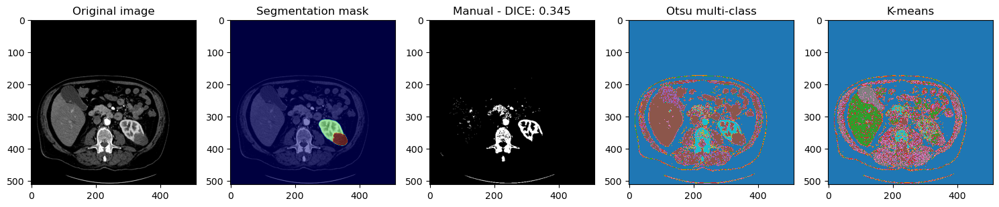

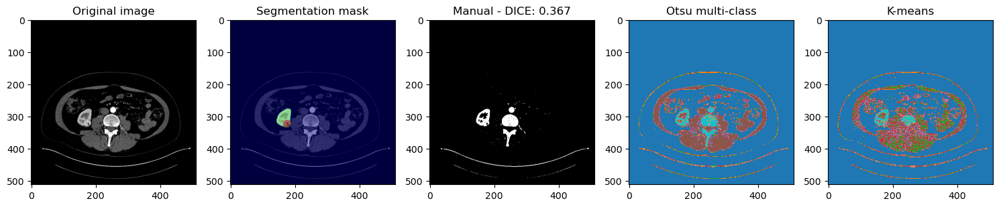

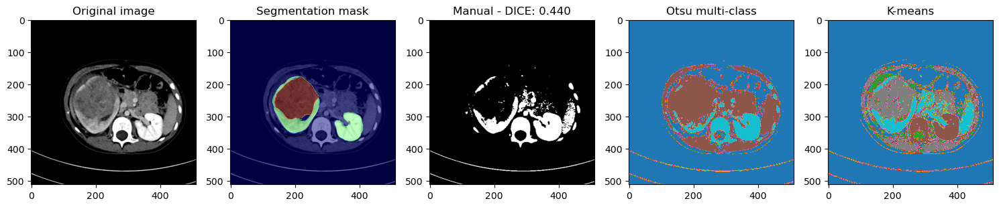

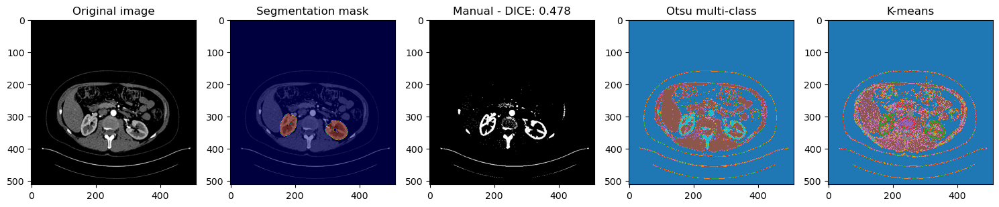

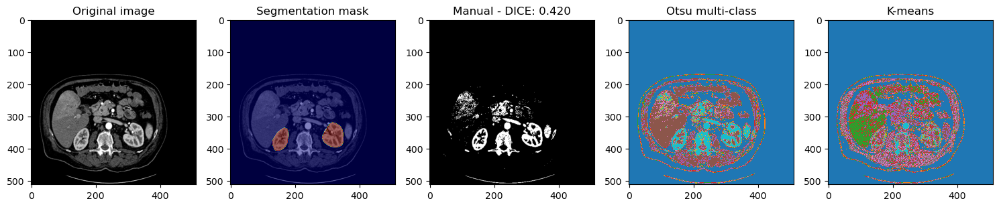

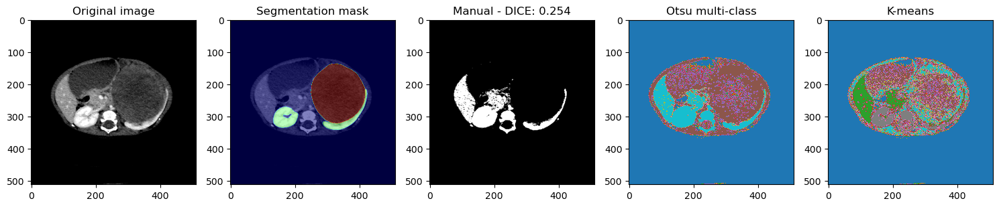

In [10]:
N_CLUSTERS_KMEANS = 5
N_CLASSES_OTSU = 3

file_path = Working_directory + 'abdominalCT'
list_images = glob.glob(file_path + '/*-seg.tiff')

for i in range(len(list_images)):
    filename = list_images[i]
    im_Seg = imread(filename)
    filename = filename[:-9] + '.tiff'
    imG = imread(filename, as_gray=True)
    imG = imG / imG.max()

    plt.figure(figsize=(15, 10))
    plt.subplot(1, 5, 1)
    plt.imshow(imG, cmap='gray')
    plt.title('Original image')

    plt.subplot(1, 5, 2)
    plt.imshow(imG, cmap='gray')
    plt.imshow(im_Seg, cmap='jet', alpha=0.5)
    plt.title('Segmentation mask')

    # Manual thresholding
    thresh = 0.5
    binary = (imG > thresh) * 255
    dice_manual = Dice(im_Seg, binary)
    plt.subplot(1, 5, 3)
    plt.imshow(binary, cmap='gray')
    plt.title('Manual - DICE: {:.3f}'.format(dice_manual))

    # Otsu multi-class thresholding
    thresh_multi = threshold_multiotsu(imG, classes=N_CLASSES_OTSU)
    plt.subplot(1, 5, 4)
    plt.imshow(np.digitize(imG, bins=thresh_multi), cmap='tab10')
    plt.title('Otsu multi-class')

    # k-means thresholding
    imG_flat = imG.flatten().reshape(-1, 1)
    kmeans = KMeans(n_clusters=N_CLUSTERS_KMEANS, random_state=0).fit(imG_flat)
    plt.subplot(1, 5, 5)
    plt.imshow(kmeans.labels_.reshape(imG.shape), cmap='tab10')
    plt.title('K-means')

    plt.tight_layout()
    plt.show()

As we had anticipated, manual thresholding is pretty worthless with more complicated images such as the ones in the Abdominal CT dataset seen above. Furthermore, we've resorted to multi-class labeling, in the cases of Otsu and K-means, since otherwise we wouldn't be able to extract any meaningful structure from the images. We observe there seems to be some primarily promising results. However, there seems to be a strong need for pre and post processing, for instance, to make the labeling less grainy and in order to automatically select the label corresponding to the segmentation.

We set the number of classes for Otsu at 3 in this case based on our observations of the histograms in the previous part, while experimentally we found that 5 clusters worked best for K-means in this case.

### Brain MRI

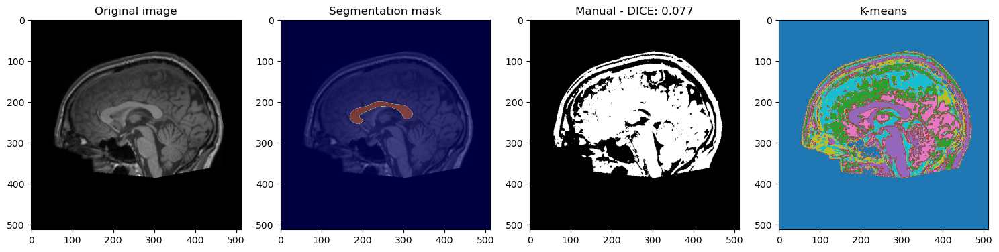

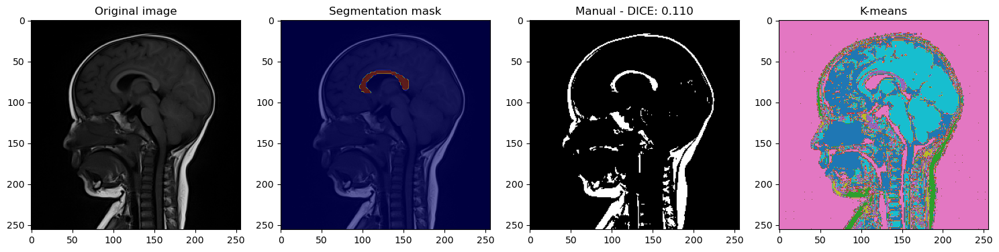

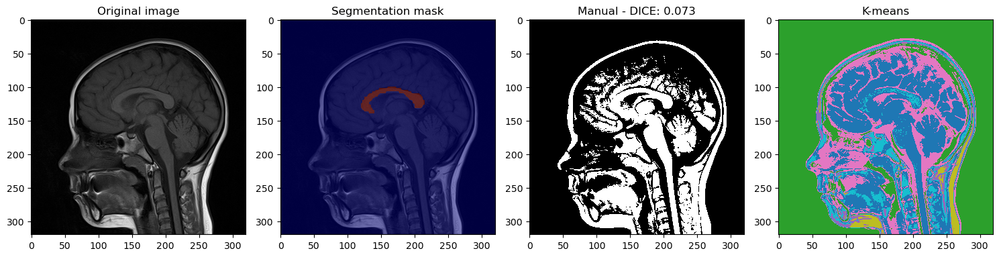

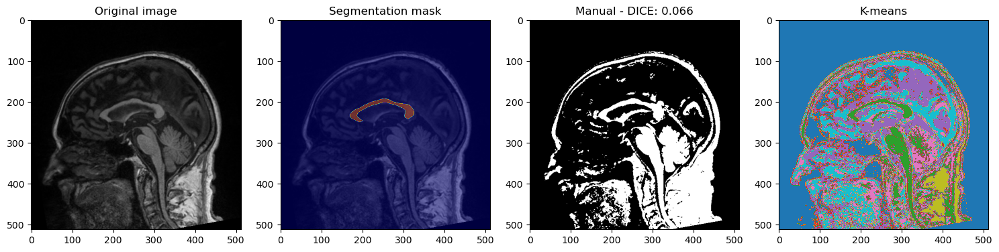

In [11]:
N_CLUSTERS_KMEANS = 6
#N_CLASSES_OTSU = 3

file_path = Working_directory + 'brainMRI'
list_images = glob.glob(file_path + '/*-seg.png')

for i in range(len(list_images)):
    filename = list_images[i]
    im_Seg = imread(filename)
    filename = filename[:-8] + '.png'
    imG = imread(filename, as_gray=True)
    imG = imG / imG.max()

    plt.figure(figsize=(15, 10))
    plt.subplot(1, 4, 1)
    plt.imshow(imG, cmap='gray')
    plt.title('Original image')

    plt.subplot(1, 4, 2)
    plt.imshow(imG, cmap='gray')
    plt.imshow(im_Seg, cmap='jet', alpha=0.5)
    plt.title('Segmentation mask')

    # Manual thresholding
    thresh = 0.2
    binary = (imG > thresh) * 255
    dice_manual = Dice(im_Seg, binary)
    plt.subplot(1, 4, 3)
    plt.imshow(binary, cmap='gray')
    plt.title('Manual - DICE: {:.3f}'.format(dice_manual))

    # # Otsu multi-class thresholding
    # thresh_multi = threshold_multiotsu(imG, classes=N_CLASSES_OTSU, nbins=32)
    # plt.subplot(1, 5, 4)
    # plt.imshow(np.digitize(imG, bins=thresh_multi), cmap='tab10')
    # plt.title('Otsu multi-class')

    # k-means thresholding
    imG_flat = imG.flatten().reshape(-1, 1)
    kmeans = KMeans(n_clusters=N_CLUSTERS_KMEANS, random_state=0).fit(imG_flat)
    plt.subplot(1, 4, 4)
    plt.imshow(kmeans.labels_.reshape(imG.shape), cmap='tab10')
    plt.title('K-means')

    plt.tight_layout()
    plt.show()

We see that even though K-means seems to manage to extract some useful information, segmentation using thresholding will be quite hard on this dataset, as predicted from the histograms.

One way in which we could maybe improve performance of thresholding methods on this dataset would be to crop the image around the corpus callosum we want to segment, and then try to threhshold this cropped image. However, within this dataset the position of the structure is not in a very predictable or constant area, which makes creating a segmentation pipeline for it using thresholding quite difficult. 

Note that for this dataset, we didn't experiment further with Otsu thresholding since it was computationally very slow and didn't provide results which posed any clear advantage over K-Means. 

### Skin lesions

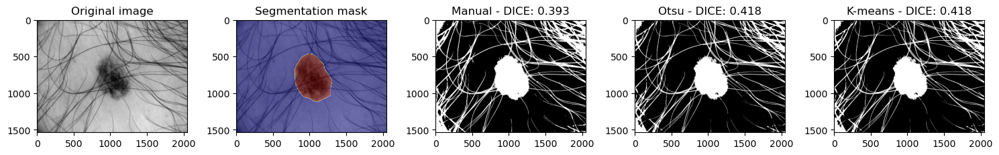

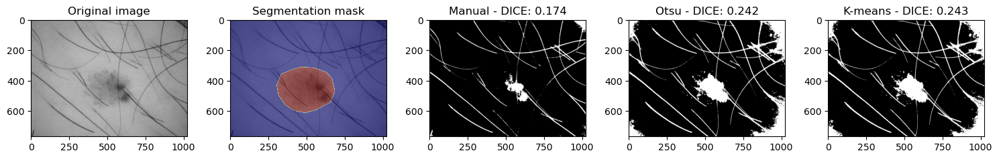

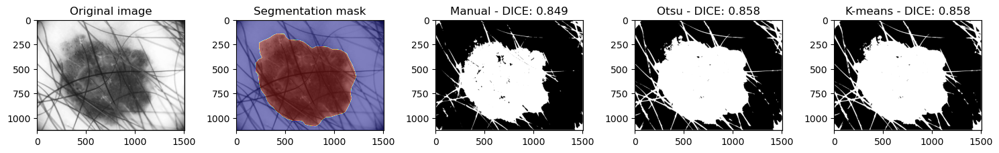

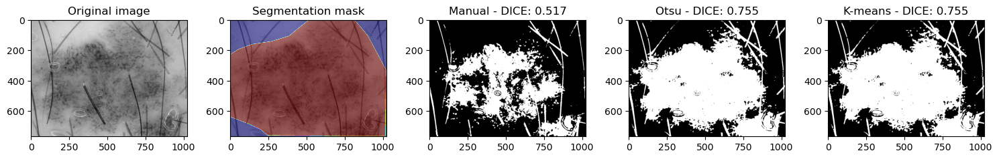

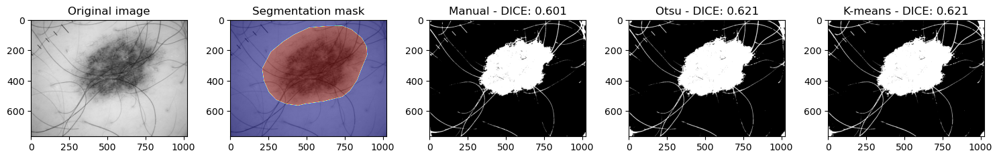

...

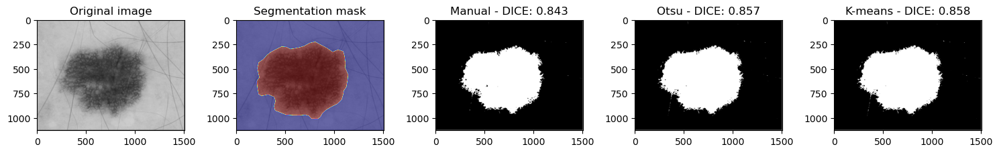

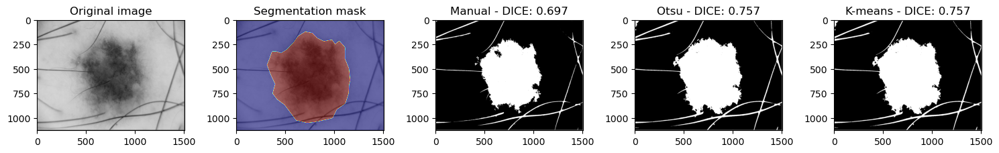

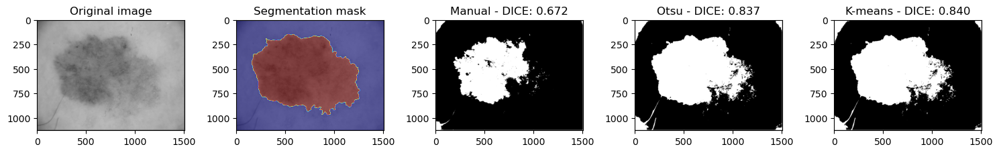

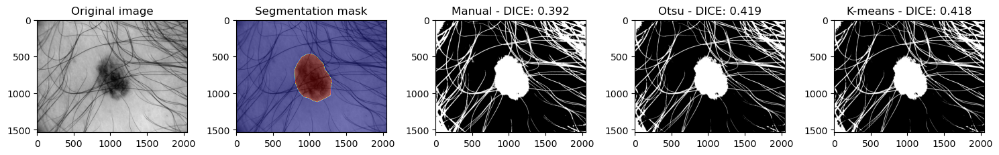

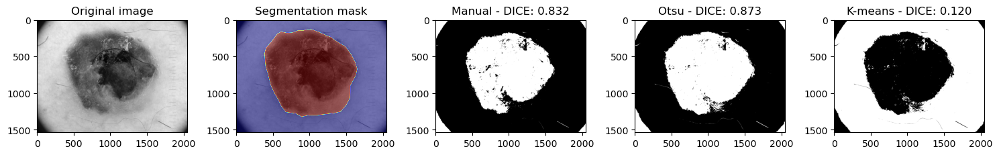

In [12]:
file_path = Working_directory + 'skinlesion'
list_images = glob.glob(file_path + '/*_Segmentation.png')

# Select a random subsample of list_images
# np.random.seed(0)
# list_images = np.random.choice(list_images, 5)

for i in range(len(list_images)):
    filename = list_images[i]
    im_Seg = imread(filename)
    filename = filename[:-17] + '.jpg'
    imG = imread(filename, as_gray=True)

    plt.figure(figsize=(15, 10))
    plt.subplot(1, 5, 1)
    plt.imshow(imG, cmap='gray')
    plt.title('Original image')

    plt.subplot(1, 5, 2)
    plt.imshow(imG, cmap='gray')
    plt.imshow(im_Seg, cmap='jet', alpha=0.5)
    plt.title('Segmentation mask')

    # Manual thresholding
    thresh = 0.5
    binary = (imG < thresh) * 255
    dice_manual = Dice(im_Seg, binary)
    plt.subplot(1, 5, 3)
    plt.imshow(binary, cmap='gray')
    plt.title('Manual - DICE: {:.3f}'.format(dice_manual))

    # Otsu thresholding
    threshOtsu = threshold_otsu(imG)
    binaryOtsu = (imG < threshOtsu) * 255
    dice_otsu = Dice(im_Seg, binaryOtsu)
    plt.subplot(1, 5, 4)
    plt.imshow(binaryOtsu, cmap="gray")
    plt.title('Otsu - DICE: {:.3f}'.format(dice_otsu))

    # k-means thresholding
    imG_flat = imG.flatten().reshape(-1, 1)
    kmeans = KMeans(n_clusters=2, random_state=0).fit(imG_flat)
    binaryKmeans = (kmeans.labels_.reshape(imG.shape) == 0) * 255
    dice_kmeans = Dice(im_Seg, binaryKmeans)
    plt.subplot(1, 5, 5)
    plt.imshow(binaryKmeans, cmap='gray')
    plt.title('K-means - DICE: {:.3f}'.format(dice_kmeans))

    plt.tight_layout()
    plt.show()

In the previous plots we observe the results of the different types of threhsholding we can choose on the Skin Lesion dataset. The first comment we can make, which is something we expected, is that manual thresholding produces the worst and least robust results. This is because even throughout a single dataset, the variance in image intensities will vary greatly and we can't expect a single value to work well for every image. 

We observe that in a lot of cases in the above plots, the DICE score for K-Means is lower than for Otsu. However, this is not necessarily caused by the fact that the obtained segmentation is worse, but because the label assigned by K-means for the segmentation isn't the correct one. Post-processing would be needed to automatically select the correct label, for example by selecting the label corresponding to the largest connected component whose center is closest to the expected center of the structure we want to segment. However, this will be dependent on the dataset, for instance, with skin lessions we can expect the center of mass of the connected component in which we're interested (the lesion) will be close to the center of the image. We'll explore this in the following sections of the practical work.

Aside from the previous comment, we observe that Otsu and K-means have pretty similar performances. From a theoretical perspective, we know that Otsu is a global optimization method, while K-means is only a local optimal method. The basic version of Otsu only accounts for 2 classes, while K-means can be easily set up to work with any number of clusters. However, we will experiment also with multi-class Otsu in the following parts of the practical work. Being able to segment numerous classes can be an advantage for some types of images, but for others it's irrelevant. For instance, in the Skin Lession dataset we'll be interested in only having two clusters (Lesion and background), while for other types of images it might be interesting to have numerous different labels. 

### MRI heart

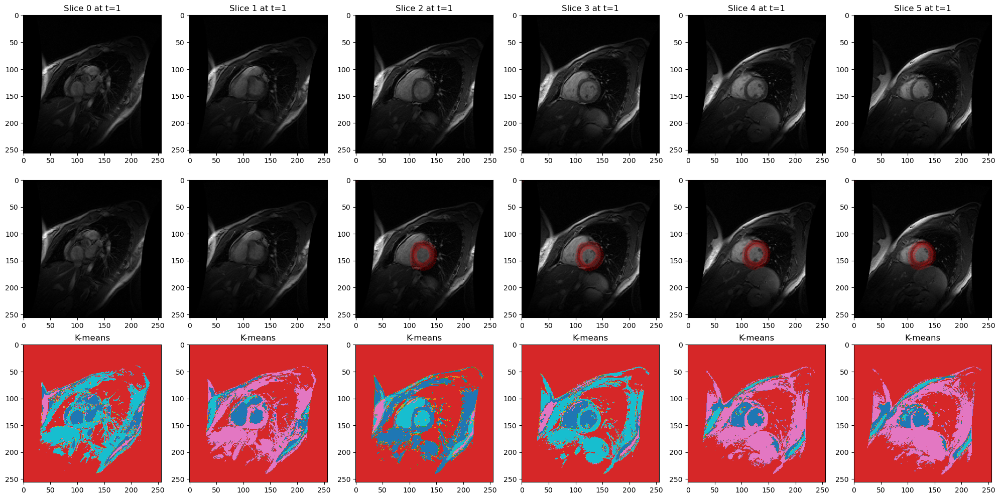

In [13]:
MRIheart_path = Working_directory + 'MRIheart/'
data = loadmat(MRIheart_path + 'dataMRIheart.mat')
data = data['data']
seg = loadmat(MRIheart_path + 'segMRIheart.mat')
seg = seg['seg']

# Select a time between 0 and 19
TIMEFRAME = 1

fig, ax = plt.subplots(3, 6)

# Set figsize
fig.set_figheight(10)
fig.set_figwidth(20)

# Segment with K-Means
N_CLUSTERS_KMEANS = 4

# Plot image, segmentation mask and obtained segmentation with K-Means
for i in range(6):
    # Image
    ax[0, i].imshow(data[:, :, i, TIMEFRAME], cmap='gray')
    ax[0, i].set_title(f'Slice {i} at t={TIMEFRAME}')

    # Segmentation
    ax[1, i].imshow(data[:, :, i, TIMEFRAME], cmap='gray')
    if len(seg[i, TIMEFRAME]) > 1:
        ax[1, i].scatter(seg[i, TIMEFRAME][:, 0], seg[i, TIMEFRAME][:, 1], c='r', alpha=0.1)
    
    # K-Means
    imG = data[:, :, i, TIMEFRAME]
    imG = imG / imG.max()
    imG_flat = imG.flatten().reshape(-1, 1)
    kmeans = KMeans(n_clusters=N_CLUSTERS_KMEANS, random_state=0).fit(imG_flat)
    ax[2, i].imshow(kmeans.labels_.reshape(imG.shape), cmap='tab10')
    ax[2, i].set_title('K-means')

plt.tight_layout()
plt.show()

For the Heart MRIs, we focused mainly on trying to experiment thresholding with K-means, since manual and Otsu thresholding don't provide any better results. We can observe that even though some of the ventricle wall structure is captured, it's impossible for thresholding methods to differentiate it from other of the structures present in the image, as we had predicted from looking at the histograms.

# Segmentation using thresholding

Through our experiments, we conclude that in this case this segmentation method is best adapted for Skin lesion images. However, we present also our less successful experiments on the other datasets.

### Skin lesions

With thresholding, we obtained an average DICE score of 90% over the whole dataset using our proposed segmentation pipeline:

1. Select an image and convert it to grayscale. 
2. Perform inpainting to remove the hairs from the image using mathematical morphology (subsequent dilation and maximum operation by lines of different orientation).
3. Threshold using Otsu.
4. Select the connected component of the resulting threshold whose center is closest to the center of the image.
5. Perform morphological closing to remove small holes in the resulting segmentation.
6. Perform morphological dilation to "regularize" the mask shape. 

In [14]:
def remove_hairs(imG):
    angles = np.arange(0, 180, 1)
    for angle, i in enumerate(angles):
        se = strel('line', 20, angle)
        dilation = morpho.dilation(imG, se)
        if i > 0:
            res = np.maximum(res, dilation)
        else:
            res = dilation
    return res

# Select connected component whose center is the closest to the center of the image
def select_component(mask):    
    # Apply a Gaussian blur to the image to regularize shapes
    mask = gaussian(mask, sigma=10)
    # Threshold to get a binary image
    thresh = threshold_otsu(mask)
    mask = mask > thresh
    # Label connected components
    labeled, ncomponents = ndi.label(mask)
    # Compute the center of the image
    center = np.array(mask.shape) / 2
    # Compute the center of each connected component
    centers = np.array([ndi.center_of_mass(labeled == i) for i in range(1, ncomponents + 1)])    
    # Compute the distance between the center of the image and the center of each connected component
    distances = np.linalg.norm(centers - center, axis=1)
    # Select the connected component whose center is the closest to the center of the image
    selected = np.argmin(distances) + 1
    return labeled == selected

def seg_thresh_skin_lesion(filename):
    imG = imread(filename, as_gray=True)
    imG_inpaint = remove_hairs(imG)
    threshOtsu = threshold_otsu(imG_inpaint)
    binaryOtsu = (imG_inpaint < threshOtsu) * 255
    res_seg = select_component(binaryOtsu)
    res_seg = morpho.closing(res_seg, strel('disk', 10))
    res_seg = morpho.dilation(res_seg, strel('disk', 50))
    return res_seg

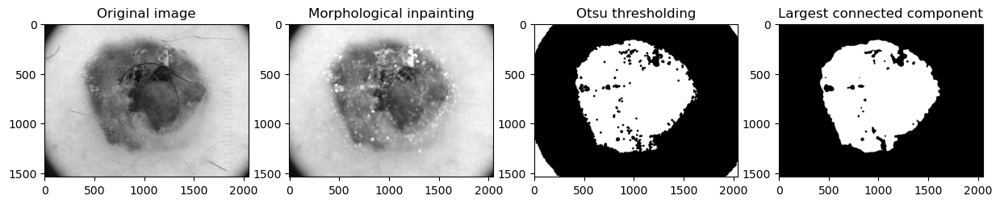

In [15]:
# Thresholding with Otsu after morphological inpainting
file_path = Working_directory + 'skinlesion'
list_images = glob.glob(file_path + '/*_Segmentation.png')
index = 12
filename = list_images[index]
im_Seg = imread(filename)
filename = filename[:-17] + '.jpg'
imG = imread(filename)

# Convert the image to grayscale by averaging the three channels
imG = np.mean(imG, axis=2)

imG_inpaint = remove_hairs(imG)
threshOtsu = threshold_otsu(imG_inpaint)
binaryOtsu = (imG_inpaint < threshOtsu) * 255

# Keep only the largest connected component
res_seg = select_component(binaryOtsu)

plt.figure(figsize=(15, 10))
plt.subplot(1, 4, 1)
plt.imshow(imG, cmap='gray')
plt.title('Original image')

plt.subplot(1, 4, 2)
plt.imshow(imG_inpaint, cmap='gray')
plt.title('Morphological inpainting')

plt.subplot(1, 4, 3)
plt.imshow(binaryOtsu, cmap='gray')
plt.title('Otsu thresholding')

plt.subplot(1, 4, 4)
plt.imshow(res_seg, cmap='gray')
plt.title('Largest connected component')

plt.show()

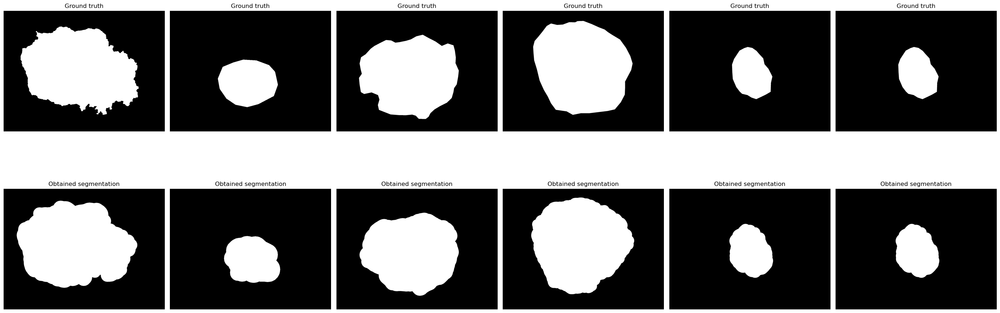

In [16]:
file_path = Working_directory + 'skinlesion'
list_images = glob.glob(file_path + '/*_Segmentation.png')

# Select random 6 images from list_images
list_images_choice = np.random.choice(list_images, 6, replace=False)

plt.figure(figsize=(60, 10))
for i in range(len(list_images_choice)):
    filename = list_images_choice[i]
    im_seg = imread(filename)
    filename = filename[:-17] + '.jpg'
    res_seg = seg_thresh_skin_lesion(filename)

    plt.subplot(2, len(list_images), i+1)
    plt.imshow(im_seg, cmap='gray')
    plt.title('Ground truth')
    plt.axis('off')

    plt.subplot(2, len(list_images), i+1+len(list_images))
    plt.imshow(res_seg, cmap='gray')
    plt.title('Obtained segmentation')
    plt.axis('off')

plt.tight_layout()
plt.show()

In [17]:
# Compute the average DICE index for the skin lesion images using the thresholding method
dice_values = []
for filename in list_images:
    im_seg = imread(filename, as_gray=True)
    filename = filename[:-17] + '.jpg'
    print(f'Processing {filename}')
    res_seg = seg_thresh_skin_lesion(filename)
    dice_values.append(Dice(im_seg, res_seg))
    print(f'DICE index: {dice_values[-1]}')

print(f'Average DICE index for the skin lesion images: {np.mean(dice_values)}')

Processing ./dataTPseg/skinlesion\IM_000180.jpg
DICE index: 0.9310472886995372
Processing ./dataTPseg/skinlesion\IM_000215.jpg
DICE index: 0.8902574434231161
Processing ./dataTPseg/skinlesion\IM_000407.jpg
DICE index: 0.9326418035083329
Processing ./dataTPseg/skinlesion\IM_000445.jpg
DICE index: 0.9460781454677867
Processing ./dataTPseg/skinlesion\IM_000510.jpg
DICE index: 0.87533648369697
Processing ./dataTPseg/skinlesion\IM_000613.jpg
DICE index: 0.7993668631388043
Processing ./dataTPseg/skinlesion\IM_000833.jpg
DICE index: 0.928823474696859
Processing ./dataTPseg/skinlesion\ISIC_0000001.jpg
DICE index: 0.7222834278453293
Processing ./dataTPseg/skinlesion\ISIC_0000019.jpg
DICE index: 0.9680695355172237
Processing ./dataTPseg/skinlesion\ISIC_0000042.jpg
DICE index: 0.9302751444230485
Processing ./dataTPseg/skinlesion\ISIC_0000046.jpg
DICE index: 0.9137452936079938
Processing ./dataTPseg/skinlesion\ISIC_0000095.jpg
DICE index: 0.9249593903235112
Processing ./dataTPseg/skinlesion\ISIC_0

### Abdominal CT

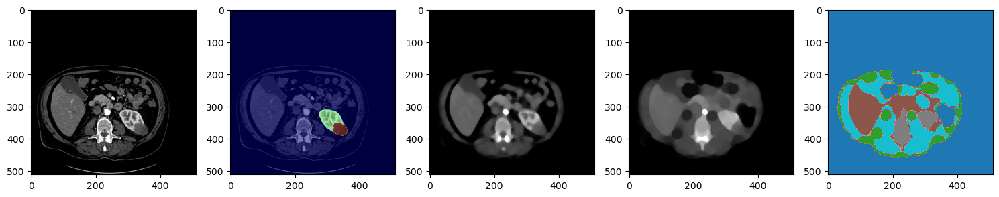

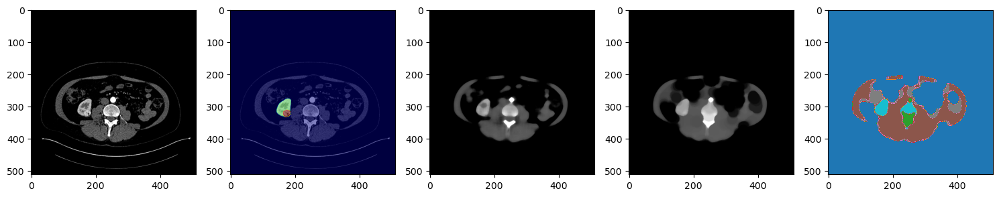

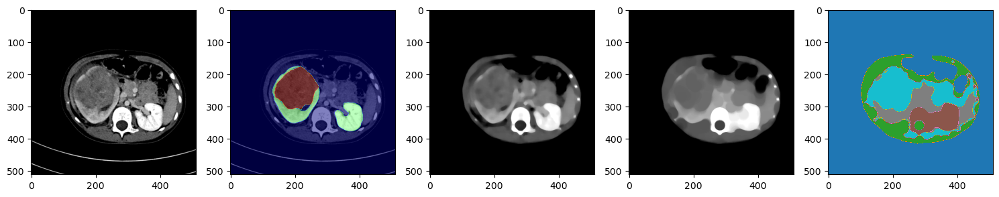

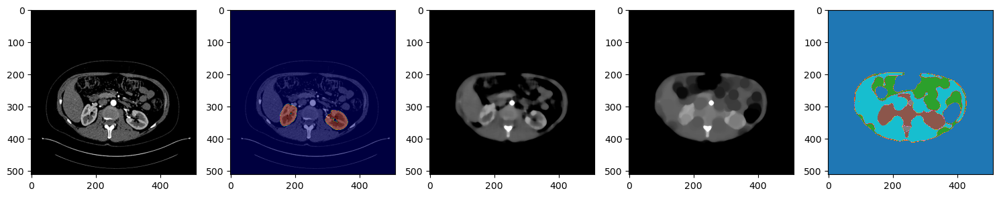

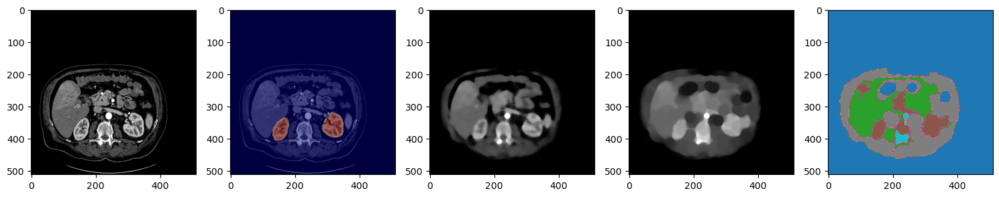

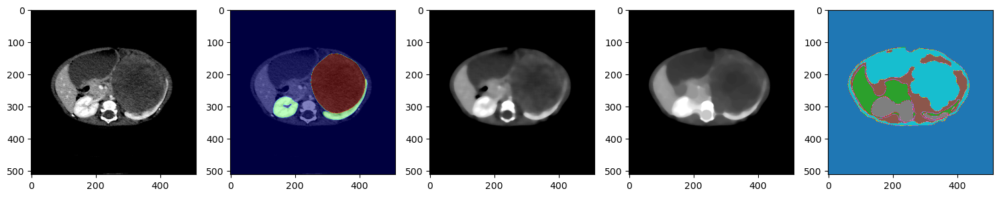

In [18]:
N_CLUSTERS_KMEANS = 5

file_path = Working_directory + 'abdominalCT'
list_images = glob.glob(file_path + '/*-seg.tiff')

for i in range(len(list_images)):
    filename = list_images[i]
    im_Seg = imread(filename)
    filename = filename[:-9] + '.tiff'
    imG = imread(filename, as_gray=True)
    imG = imG / imG.max()

    plt.figure(figsize=(15, 10))

    plt.subplot(1, 5, 1)
    plt.imshow(imG, cmap='gray')

    plt.subplot(1, 5, 2)
    plt.imshow(imG, cmap='gray')
    plt.imshow(im_Seg, cmap='jet', alpha=0.5)

    # Median filtering
    imG = ndi.median_filter(imG, size=15)
    plt.subplot(1, 5, 3)
    plt.imshow(imG, cmap='gray')
    
    # Morpho closing
    se = strel('disk', 15)
    imG = morpho.closing(imG, se)
    plt.subplot(1, 5, 4)
    plt.imshow(imG, cmap='gray')

    # K-means thresholding
    imG_flat = imG.flatten().reshape(-1, 1)
    kmeans = KMeans(n_clusters=N_CLUSTERS_KMEANS, random_state=0).fit(imG_flat)
    plt.subplot(1, 5, 5)
    plt.imshow(kmeans.labels_.reshape(imG.shape), cmap='tab10')

    # # For each label in Kmeans perform morphological operations
    # km_labels = kmeans.labels_.copy()
    # for label in np.unique(km_labels):
    #     mask = (km_labels == label).reshape(imG.shape)
    #     mask = morpho.opening(mask, strel('disk', 20))
    #     # Reshape the mask to a 1D array
    #     mask = mask.flatten()
    #     km_labels[mask] = label
    # plt.subplot(1, 5, 5)
    # plt.imshow(km_labels.reshape(imG.shape), cmap='tab10')
    
    plt.tight_layout()
    plt.show()

Although we can see some promise to this method, but we weren't able to find a great solution using segmentation by thresholding. This is mainly due to the fact that the structure to segment varies a lot in terms of shape and position, so crafting a deterministic method that will work in every case is very hard. 

### Brain MRI

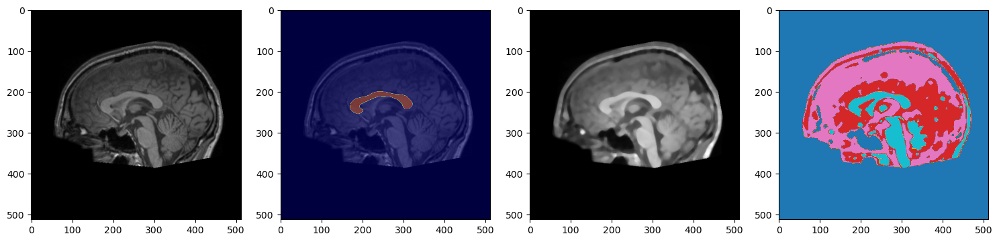

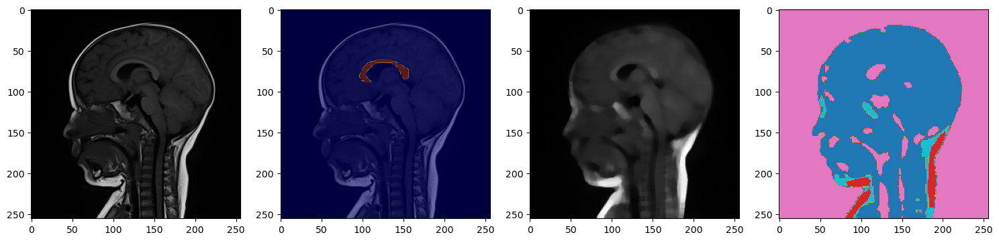

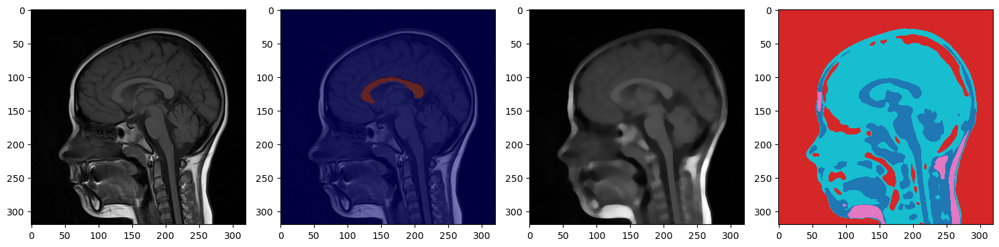

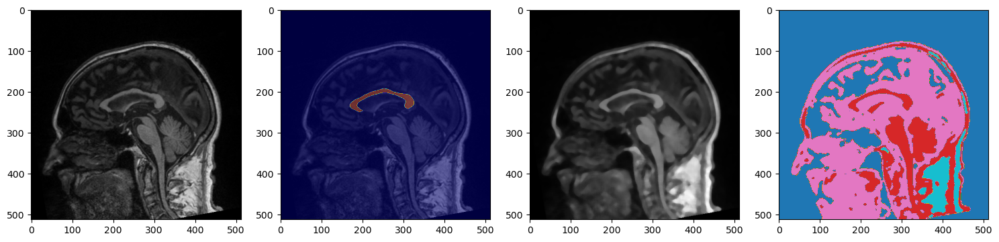

In [19]:
N_CLUSTERS_KMEANS = 4

file_path = Working_directory + 'brainMRI'
list_images = glob.glob(file_path + '/*-seg.png')

for i in range(len(list_images)):
    filename = list_images[i]
    im_Seg = imread(filename)
    filename = filename[:-8] + '.png'
    imG = imread(filename, as_gray=True)
    imG = imG / imG.max()

    plt.figure(figsize=(15, 10))

    plt.subplot(1, 4, 1)
    plt.imshow(imG, cmap='gray')

    plt.subplot(1, 4, 2)
    plt.imshow(imG, cmap='gray')
    plt.imshow(im_Seg, cmap='jet', alpha=0.5)

    # Median filtering
    imG = ndi.median_filter(imG, size=10)
    plt.subplot(1, 4, 3)
    plt.imshow(imG, cmap='gray')

    # K-means thresholding
    imG_flat = imG.flatten().reshape(-1, 1)
    kmeans = KMeans(n_clusters=N_CLUSTERS_KMEANS, random_state=0).fit(imG_flat)
    plt.subplot(1, 4, 4)
    plt.imshow(kmeans.labels_.reshape(imG.shape), cmap='tab10')
    
    plt.tight_layout()
    plt.show()

We weren't able to get a clear segmentation of the corpus callosum alone. Furthermore, we found no clear way in order to automatically select the corresponding component from the K-Means clustering. 

# Segmentation by region growing from thresholding segmentation

Since our segmentation from thresholding was the most successful with the Skin lesion images, we experimented with trying to get an even better result using region growing. We did this by modifying the region growing algorithm to accept a set of points as initial seed. Then, we passed an unrefined version of our obtained segmentation that is included in the obtained segmentation (using morphological erosion). The idea was to start the region growing algorithm with a large, amorphous seed around the center of the lesion, and have the algorithm find a refined segmentation. However, our results didn't provide any notable improvements over just performing segmentation by thresholding. What's more, some examples show unstable behaviour and result in bad segmentations.

For the other methods, the results are promising, but the seed is set manually, since no clear way to automatically get a seed point was found. 

Processing ./dataTPseg/skinlesion\IM_000180.jpg


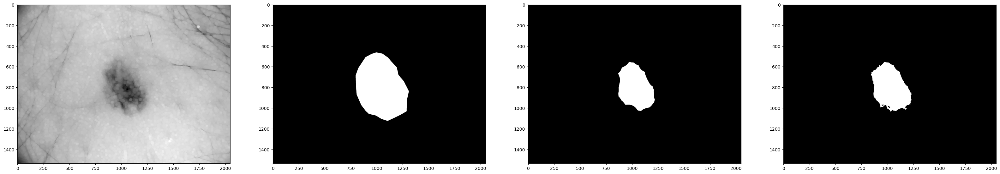

Dice index for ./dataTPseg/skinlesion\IM_000180.jpg: 0.6671511041136813
Processing ./dataTPseg/skinlesion\IM_000215.jpg


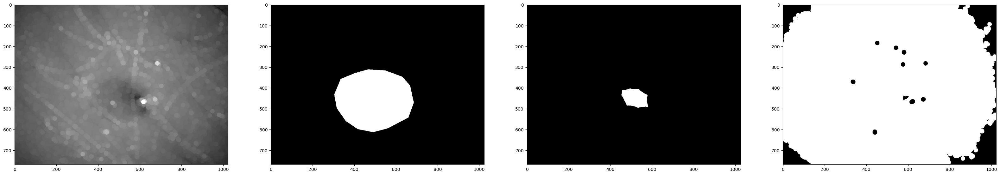

Dice index for ./dataTPseg/skinlesion\IM_000215.jpg: 0.2170284913121571
Processing ./dataTPseg/skinlesion\IM_000407.jpg


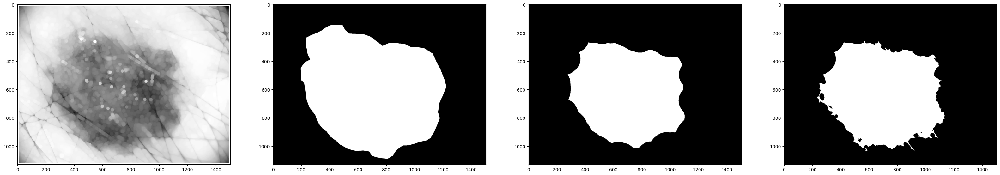

Dice index for ./dataTPseg/skinlesion\IM_000407.jpg: 0.8209935026361358
Processing ./dataTPseg/skinlesion\IM_000445.jpg


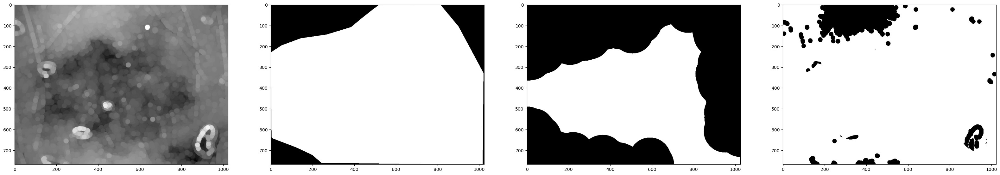

Dice index for ./dataTPseg/skinlesion\IM_000445.jpg: 0.9167266465289272
Processing ./dataTPseg/skinlesion\IM_000510.jpg


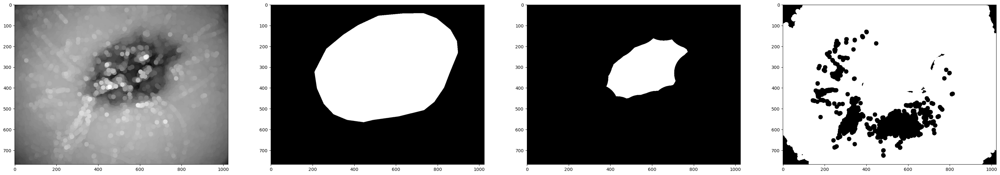

Dice index for ./dataTPseg/skinlesion\IM_000510.jpg: 0.5081871668180202
Processing ./dataTPseg/skinlesion\IM_000613.jpg


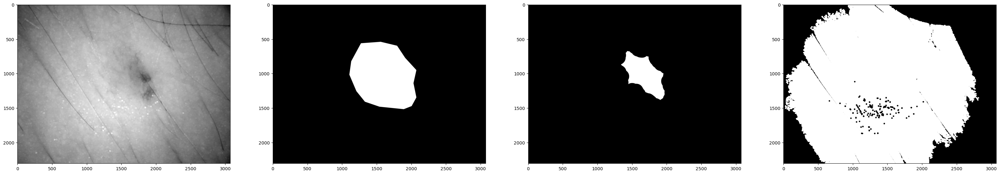

Dice index for ./dataTPseg/skinlesion\IM_000613.jpg: 0.26236522120489947
Processing ./dataTPseg/skinlesion\IM_000833.jpg


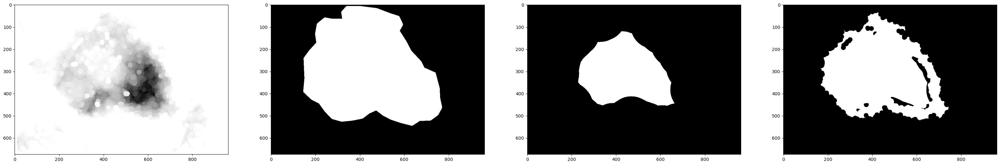

Dice index for ./dataTPseg/skinlesion\IM_000833.jpg: 0.8170058311644688
Processing ./dataTPseg/skinlesion\ISIC_0000001.jpg


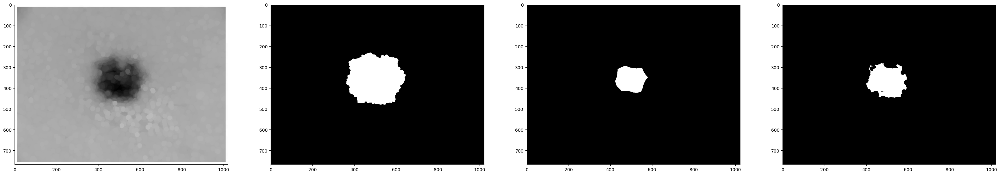

Dice index for ./dataTPseg/skinlesion\ISIC_0000001.jpg: 0.5979532930989242
Processing ./dataTPseg/skinlesion\ISIC_0000019.jpg


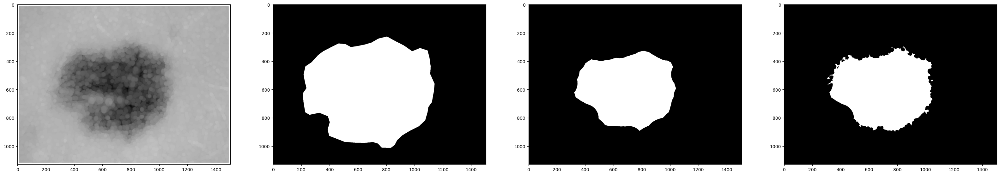

Dice index for ./dataTPseg/skinlesion\ISIC_0000019.jpg: 0.7215500574604028
Processing ./dataTPseg/skinlesion\ISIC_0000042.jpg


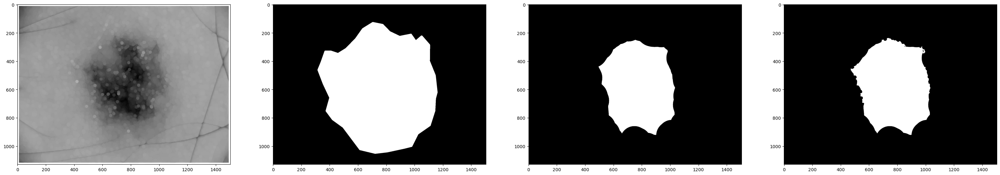

Dice index for ./dataTPseg/skinlesion\ISIC_0000042.jpg: 0.6461178204328755
Processing ./dataTPseg/skinlesion\ISIC_0000046.jpg


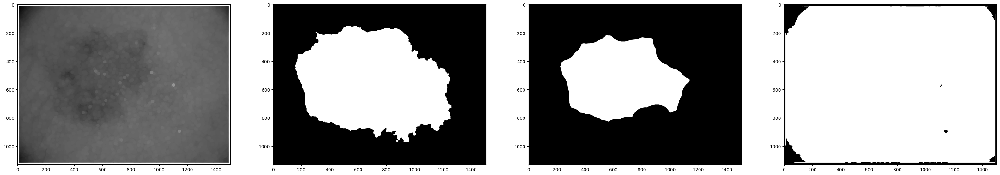

Dice index for ./dataTPseg/skinlesion\ISIC_0000046.jpg: 0.5690894364187138
Processing ./dataTPseg/skinlesion\ISIC_0000095.jpg


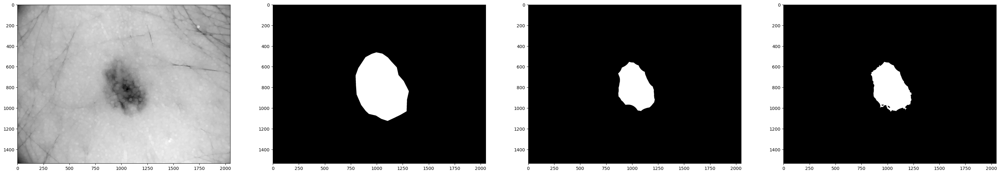

Dice index for ./dataTPseg/skinlesion\ISIC_0000095.jpg: 0.6734896812545508
Processing ./dataTPseg/skinlesion\ISIC_0000146.jpg


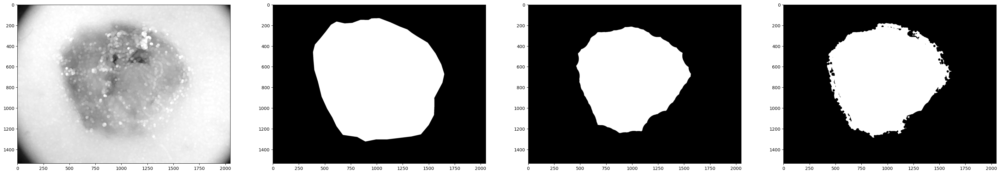

Dice index for ./dataTPseg/skinlesion\ISIC_0000146.jpg: 0.8630640704463105
Average DICE index for the skin lesion images using region growing: 0.6369786402223129


In [20]:
file_path = Working_directory + 'skinlesion'
list_images = glob.glob(file_path + '/*_Segmentation.png')
tau = 20
dice_values = []

for image in list_images:
    im_Seg = imread(image, as_gray=True)
    filename = image[:-17] + '.jpg'
    print(f'Processing {filename}')
    imG = imread(filename)
    # Keep only the R channel 
    imG = imG[:, :, 0]
    # Remove hairs
    imG = remove_hairs(imG)
    # Segment the image
    seg_thresh = seg_thresh_skin_lesion(filename)
    # Use erosion to find seed region
    seg_init = morpho.erosion(seg_thresh, strel('disk', 100))
    # Apply region growing
    img_out_region_growing, _ = segmentation_region_growing(imG, tau=tau, seg=seg_init, mode='segmentation')
    # Compute DICE   
    dice_index = Dice(im_Seg, img_out_region_growing)
    dice_values.append(dice_index)
    # Visualize
    plt.figure(figsize=(40, 10))
    plt.subplot(1, 4, 1)
    plt.imshow(imG, cmap='gray')
    plt.subplot(1, 4, 2)
    plt.imshow(im_Seg, cmap='gray')
    plt.subplot(1, 4, 3)
    plt.imshow(seg_init, cmap='gray')
    plt.subplot(1, 4, 4)
    plt.imshow(img_out_region_growing, cmap='gray')
    plt.show()

    print(f'Dice index for {filename}: {dice_index}')

print(f'Average DICE index for the skin lesion images using region growing: {np.mean(dice_values)}')

Below are some examples of the preliminary results on the Abdominal CT and Brain MRI datasets. Although the results aren't bad with specific examples, they require manual setting of the seed point and tau, which isn't very practical as an automated segmentation method, but could potentially be useful in some application in which a user could click the image and select the seed point manually. 

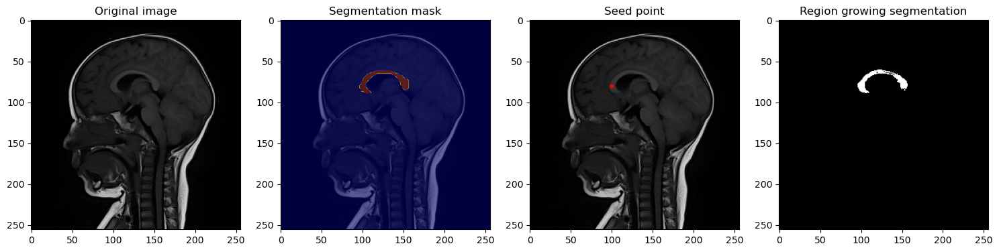

In [21]:
file_path = Working_directory + 'brainMRI'
list_images = glob.glob(file_path + '/*-seg.png')
index = 1
filename = list_images[index]
im_Seg = imread(filename)
filename = filename[:-8] + '.png'
im = imread(filename, as_gray=True)
im = im / im.max()

seed_pt = np.array([80, 100])
tau = 0.04

img_out_region_growing, seg_init = segmentation_region_growing(im, tau, seed_pt=seed_pt, mode='seed')

plt.figure(figsize=(15, 10))
plt.subplot(1, 4, 1)
plt.imshow(im, cmap='gray')
plt.title('Original image')

# Show segmentation mask
plt.subplot(1, 4, 2)
plt.imshow(im, cmap='gray')
plt.imshow(im_Seg, alpha=0.5, cmap='jet')
plt.title('Segmentation mask')

# Show seed point
plt.subplot(1, 4, 3)
plt.imshow(im, cmap='gray')
plt.scatter(seed_pt[1], seed_pt[0], c='r', s=10)
plt.title('Seed point')

# Show region growing segmentation
plt.subplot(1, 4, 4)
plt.imshow(img_out_region_growing, cmap='gray')
plt.title('Region growing segmentation')

plt.tight_layout()
plt.show()

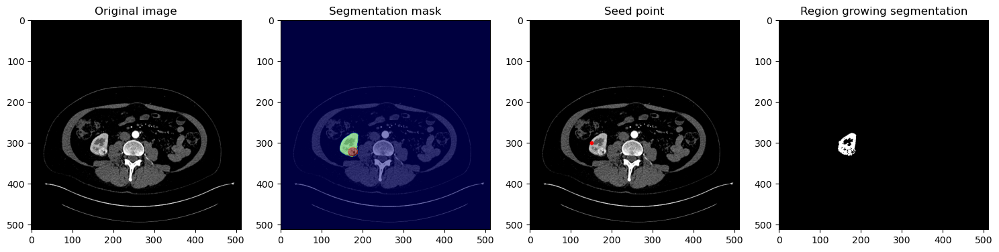

In [22]:
file_path = Working_directory + 'abdominalCT'
list_images = glob.glob(file_path + '/*-seg.tiff')
index = 1
filename = list_images[index]
im_Seg = imread(filename)
filename = filename[:-9] + '.tiff'
im = imread(filename, as_gray=True)
im = im / im.max()

seed_pt = np.array([300, 150])
tau = 0.2

img_out_region_growing, seg_init = segmentation_region_growing(im, tau, seed_pt=seed_pt, mode='seed')

plt.figure(figsize=(15, 10))
plt.subplot(1, 4, 1)
plt.imshow(im, cmap='gray')
plt.title('Original image')

# Show segmentation mask
plt.subplot(1, 4, 2)
plt.imshow(im, cmap='gray')
plt.imshow(im_Seg, alpha=0.5, cmap='jet')
plt.title('Segmentation mask')

# Show seed point
plt.subplot(1, 4, 3)
plt.imshow(im, cmap='gray')
plt.scatter(seed_pt[1], seed_pt[0], c='r', s=10)
plt.title('Seed point')

# Show region growing segmentation
plt.subplot(1, 4, 4)
plt.imshow(img_out_region_growing, cmap='gray')
plt.title('Region growing segmentation')

plt.tight_layout()
plt.show()

# Segmentation by watersheds with *markers*

In this section, we will perform the segmentation task using Watershed Segmentation with Markers, a technique that involves treating the grayscale image as a topographical surface. The algorithm simulates water filling up basins from designated marker points, with the boundaries between basins forming segmentation lines as the water levels meet. This method is particularly effective in distinguishing touching or overlapping objects.

We will apply this technique to various imaging modalities and discuss the specific characteristics and challenges associated with using the watershed algorithm in each case.

In our case, since we are primarily working with MRI and CT images, the data is often close to binary images, which means that clear gradients and intensity variations necessary for identifying regional minima may be insufficient or absent. This limitation makes automatic detection of regional minima challenging because the images lack the subtle intensity changes that typically guide the watershed algorithm to delineate regions accurately. As a result, relying solely on automatic regional minima detection can lead to over-segmentation or inaccurate boundaries.

To address this, we prefer to choose markers manually. By manually placing markers, we ensure that the algorithm starts from controlled, meaningful positions, thereby improving the segmentation accuracy by guiding the watershed process to focus on relevant structures in the image.

## MRI of the Brain

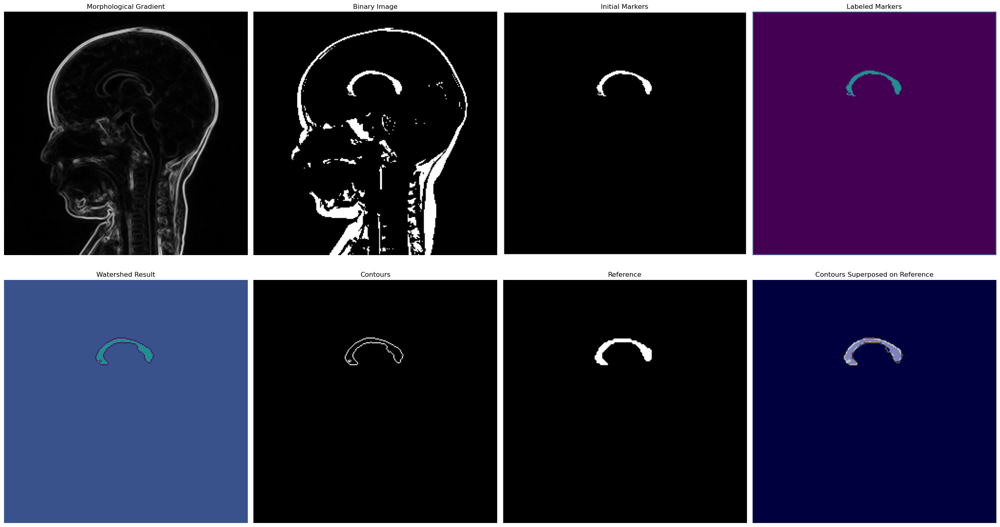

In [23]:
brainMRI_path = Working_directory + '/brainMRI'
pathi_seg = brainMRI_path + "/MRIs2-seg.png"
pathi = brainMRI_path + "/MRIs2.png"

# Reading the images
im_Seg = imread(pathi_seg)
im = imread(pathi)

# Normalize if needed
if (np.max(im) > 256):
    im = (im / 256).astype('uint8')

# Morphological gradient
se = morpho.disk(1)
grad = morpho.dilation(im, se) - morpho.erosion(im, se)
#grad=morpho.dilation(grad, se_2)

# Thresholding for binary image
threshOtsu = 50
binary = (im > threshOtsu) * 255

# Define initial markers
temp = np.zeros((binary.shape[0], binary.shape[1]), dtype=np.uint8)
for i in range(50, 100):
    for j in range(75, 175):
        temp[i, j] = 255
init = np.minimum(binary, temp)

# Add a marker at the border of the image
init[:, 0] = 255
init[:, -1] = 255
init[0, :] = 255
init[-1, :] = 255

# Label markers
markers = ndi.label(init)[0]

# Watershed segmentation
labels = watershed(grad, markers, watershed_line=True)

# Create the contour visualization
segm = labels.copy()
segm[segm == 0] = 255
segm[segm != 255] = 0

# Plotting all figures in subplots
fig, axes = plt.subplots(2, 4, figsize=(25, 14))
axes = axes.ravel()  # Flatten the 2D array of axes for easy iteration

# Display images
axes[0].imshow(grad, cmap="gray")
axes[0].set_title("Morphological Gradient")
axes[0].axis('off')

axes[1].imshow(binary, cmap="gray")
axes[1].set_title("Binary Image")
axes[1].axis('off')

axes[2].imshow(init, cmap="gray")
axes[2].set_title("Initial Markers")
axes[2].axis('off')

axes[3].imshow(markers)
axes[3].set_title("Labeled Markers")
axes[3].axis('off')

axes[4].imshow(labels)
axes[4].set_title("Watershed Result")
axes[4].axis('off')

axes[5].imshow(segm, cmap="gray")
axes[5].set_title("Contours")
axes[5].axis('off')

axes[6].imshow(im_Seg, cmap="gray")
axes[6].set_title("Reference")
axes[6].axis('off')

# Superimpose contour on the reference image
axes[7].imshow(im_Seg, cmap="gray")
axes[7].imshow(segm, cmap="jet", alpha=0.5)  # Overlay with transparency
axes[7].set_title("Contours Superposed on Reference")
axes[7].axis('off')

# Hide any unused subplots
for i in range(8, len(axes)):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

The results we obtained are mostly satisfactory, with a successful segmentation of the Corpus Callosum. An important remark worth mentioning is that, in some implementations of the watershed method, it is common practice to dilate the binary image (init in our case) before applying the watershed operation. This is often done to eliminate black areas and ensure a well-defined foreground. However, in the specific case of Corpus Callosum segmentation, caution must be exercised when using this technique. Applying dilation can cause the markers to extend beyond the gradient boundaries of the target structure. Since the Corpus Callosum has a thin structure, this can result in the segmentation extending to the entire skull periphery, as the watershed surpasses the intended target and reaches unintended areas.

## MRI of the Heart

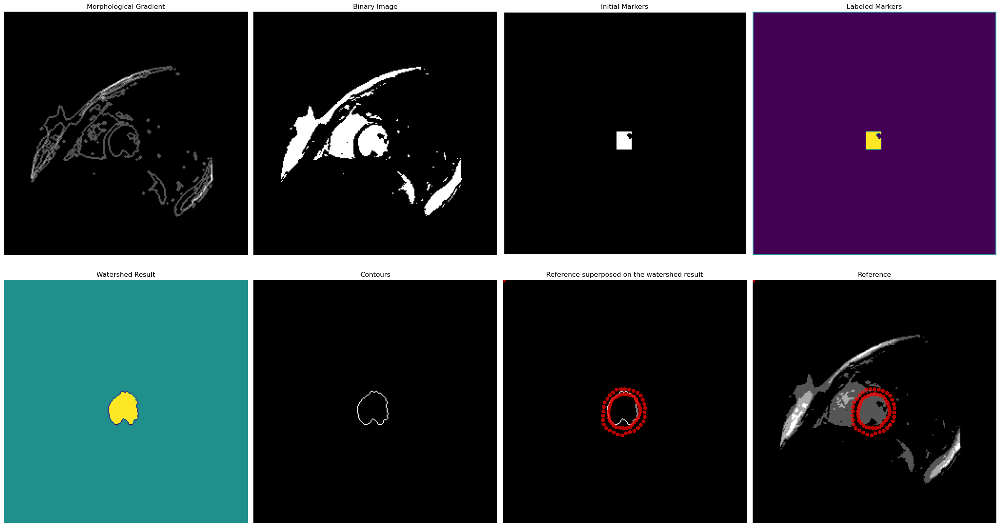

In [24]:
MRIheart_path = Working_directory + 'MRIheart/' 

data=loadmat(MRIheart_path + 'dataMRIheart.mat')
data=data['data']
seg=loadmat(MRIheart_path + 'segMRIheart.mat')
seg=seg['seg']

# Reading the images
im = data[:,:,4,1]


# Normalize if needed
if (np.max(im) > 256):
    im = (im / 256).astype('uint8')

# Morphological gradient
se = morpho.disk(1)
grad = morpho.dilation(im, se) - morpho.erosion(im, se)


# Thresholding for binary image
threshOtsu = threshold_otsu(im)
binary = (im > threshOtsu) * 255

# Define initial markers
temp = np.zeros((binary.shape[0], binary.shape[1]), dtype=np.uint8)
for i in range(126,145):
    for j in range(119,135):
        temp[i,j]=255
init = np.minimum(binary, temp)

# Add a marker at the border of the image
init[:, 0] = 255
init[:, -1] = 255
init[0, :] = 255
init[-1, :] = 255

# Label markers
markers = ndi.label(init)[0]

# Watershed segmentation
labels = watershed(grad, markers, watershed_line=True)

# Create the contour visualization
segm = labels.copy()
segm[segm == 0] = 255
segm[segm != 255] = 0

# Plotting all figures in subplots
fig, axes = plt.subplots(2, 4, figsize=(25, 14))
axes = axes.ravel()  # Flatten the 2D array of axes for easy iteration

# Display images
axes[0].imshow(grad, cmap="gray")
axes[0].set_title("Morphological Gradient")
axes[0].axis('off')

axes[1].imshow(binary, cmap="gray")
axes[1].set_title("Binary Image")
axes[1].axis('off')

axes[2].imshow(init, cmap="gray")
axes[2].set_title("Initial Markers")
axes[2].axis('off')

axes[3].imshow(markers)
axes[3].set_title("Labeled Markers")
axes[3].axis('off')

axes[4].imshow(labels)
axes[4].set_title("Watershed Result")
axes[4].axis('off')

axes[5].imshow(segm, cmap="gray")
axes[5].set_title("Contours")
axes[5].axis('off')

axes[6].imshow(segm, cmap="gray")
axes[6].scatter(seg[4,1][:,0], seg[4,1][:,1], c='r',alpha=0.7) 
axes[6].set_title("Reference superposed on the watershed result")
axes[6].axis('off')

# Superimpose contour on the reference image
axes[7].imshow(im, cmap="gray")
axes[7].scatter(seg[4,1][:,0], seg[4,1][:,1], c='r',alpha=0.7)   # Overlay with transparency
axes[7].set_title("Reference")
axes[7].axis('off')

# Hide any unused subplots
for i in range(8, len(axes)):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

The results we obtained after applying the method to the heart MRI were good; however, we aimed to further improve the results by removing the black object located at the bottom of the target (left ventricle) that disrupts the edge and affects the accuracy of the segmentation.

Our initial idea was to apply a closing (or dilation) operation to fill this gap. The problem, as demonstrated below, is that this operation causes the left ventricle to become connected to other parts that we do not want to segment. This issue persisted for all the structuring element sizes we tested.

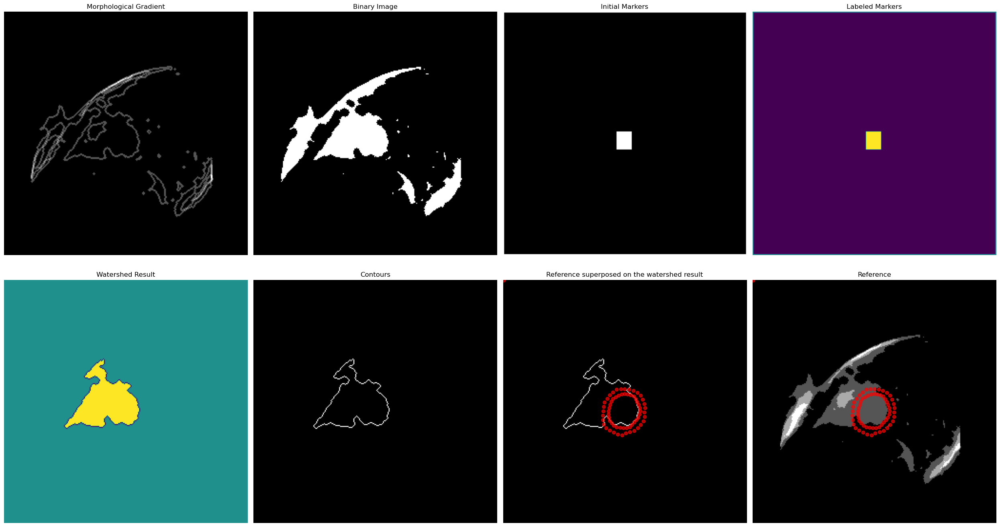

In [25]:
from skimage.morphology import reconstruction
data=loadmat(MRIheart_path + 'dataMRIheart.mat')
data=data['data']
seg=loadmat(MRIheart_path + 'segMRIheart.mat')
seg=seg['seg']

# Reading the images
im = data[:,:,4,1]

se = morpho.disk(3)

# Apply closing
im = morpho.closing(im, se)

# Normalize if needed
if (np.max(im) > 256):
    im = (im / 256).astype('uint8')

# Morphological gradient
se = morpho.disk(1)
grad = morpho.dilation(im, se) - morpho.erosion(im, se)


# Thresholding for binary image
threshOtsu = threshold_otsu(im)
binary = (im > threshOtsu) * 255

# Define initial markers
temp = np.zeros((binary.shape[0], binary.shape[1]), dtype=np.uint8)
for i in range(126,145):
    for j in range(119,135):
        temp[i,j]=255
init = np.minimum(binary, temp)

# Add a marker at the border of the image
init[:, 0] = 255
init[:, -1] = 255
init[0, :] = 255
init[-1, :] = 255

# Label markers
markers = ndi.label(init)[0]

# Watershed segmentation
labels = watershed(grad, markers, watershed_line=True)

# Create the contour visualization
segm = labels.copy()
segm[segm == 0] = 255
segm[segm != 255] = 0

# Plotting all figures in subplots
fig, axes = plt.subplots(2, 4, figsize=(25, 14))
axes = axes.ravel()  # Flatten the 2D array of axes for easy iteration

# Display images
axes[0].imshow(grad, cmap="gray")
axes[0].set_title("Morphological Gradient")
axes[0].axis('off')

axes[1].imshow(binary, cmap="gray")
axes[1].set_title("Binary Image")
axes[1].axis('off')

axes[2].imshow(init, cmap="gray")
axes[2].set_title("Initial Markers")
axes[2].axis('off')

axes[3].imshow(markers)
axes[3].set_title("Labeled Markers")
axes[3].axis('off')

axes[4].imshow(labels)
axes[4].set_title("Watershed Result")
axes[4].axis('off')

axes[5].imshow(segm, cmap="gray")
axes[5].set_title("Contours")
axes[5].axis('off')

axes[6].imshow(segm, cmap="gray")
axes[6].scatter(seg[4,1][:,0], seg[4,1][:,1], c='r',alpha=0.7) 
axes[6].set_title("Reference superposed on the watershed result")
axes[6].axis('off')

# Superimpose contour on the reference image
axes[7].imshow(im, cmap="gray")
axes[7].scatter(seg[4,1][:,0], seg[4,1][:,1], c='r',alpha=0.7)   # Overlay with transparency
axes[7].set_title("Reference")
axes[7].axis('off')

# Hide any unused subplots
for i in range(8, len(axes)):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

Another idea we proposed was to fill this gap, not with morphological operations, as these would affect and expand other parts of the left ventricle, but with classical image processing methods such as a Gaussian filter. The idea is to smooth the black object by averaging with the bright neighboring pixels. The problem with this method is that we lose edge definition due to the smoothing, resulting in an imprecise gradient image.

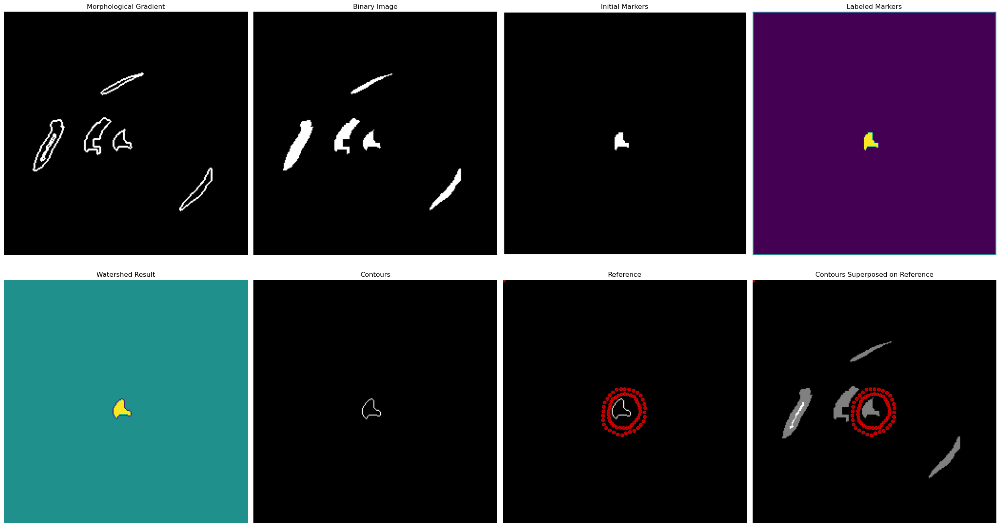

In [26]:
from scipy.ndimage import gaussian_filter
data=loadmat(MRIheart_path + 'dataMRIheart.mat')
data=data['data']
seg=loadmat(MRIheart_path + 'segMRIheart.mat')
seg=seg['seg']

# Reading the images
im = data[:,:,4,1]
# Normalize if needed
if (np.max(im) > 256):
    im = (im / 256).astype('uint8')
im=gaussian_filter(im, sigma=1)
# Morphological gradient
se = morpho.disk(1)
grad = morpho.dilation(im, se) - morpho.erosion(im, se)
#grad=morpho.dilation(grad, se_2)

# Thresholding for binary image
threshOtsu = 0
binary = (im > threshOtsu) * 255

# Define initial markers
temp = np.zeros((binary.shape[0], binary.shape[1]), dtype=np.uint8)
for i in range(127,151):
    for j in range(117,132):
        temp[i,j]=255
init = np.minimum(binary, temp)

# Add a marker at the border of the image
init[:, 0] = 255
init[:, -1] = 255
init[0, :] = 255
init[-1, :] = 255

# Label markers
markers = ndi.label(init)[0]

# Watershed segmentation
labels = watershed(grad, markers, watershed_line=True)

# Create the contour visualization
segm = labels.copy()
segm[segm == 0] = 255
segm[segm != 255] = 0

# Plotting all figures in subplots
fig, axes = plt.subplots(2, 4, figsize=(25, 14))
axes = axes.ravel()  # Flatten the 2D array of axes for easy iteration

# Display images
axes[0].imshow(grad, cmap="gray")
axes[0].set_title("Morphological Gradient")
axes[0].axis('off')

axes[1].imshow(binary, cmap="gray")
axes[1].set_title("Binary Image")
axes[1].axis('off')

axes[2].imshow(init, cmap="gray")
axes[2].set_title("Initial Markers")
axes[2].axis('off')

axes[3].imshow(markers)
axes[3].set_title("Labeled Markers")
axes[3].axis('off')

axes[4].imshow(labels)
axes[4].set_title("Watershed Result")
axes[4].axis('off')

axes[5].imshow(segm, cmap="gray")
axes[5].set_title("Contours")
axes[5].axis('off')

axes[6].imshow(segm, cmap="gray")
axes[6].scatter(seg[4,1][:,0], seg[4,1][:,1], c='r',alpha=0.7) 
axes[6].set_title("Reference")
axes[6].axis('off')

# Superimpose contour on the reference image
axes[7].imshow(im, cmap="gray")
axes[7].scatter(seg[4,1][:,0], seg[4,1][:,1], c='r',alpha=0.7)   # Overlay with transparency
axes[7].set_title("Contours Superposed on Reference")
axes[7].axis('off')

# Hide any unused subplots
for i in range(8, len(axes)):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

## Skin Lesions

For the skin lesion analysis, we aimed to test the same implementation used for the watershed method with markers in the morphological processing practical session in TADI. The principle is similar to what we applied for brain and heart MRI. Before applying the watershed, we perform a closing operation to remove thin dark regions, such as hair. However, we must be cautious with this operation; applying closing with a large structuring element size can blur the image and cause loss of boundary information for the target area we wish to segment.

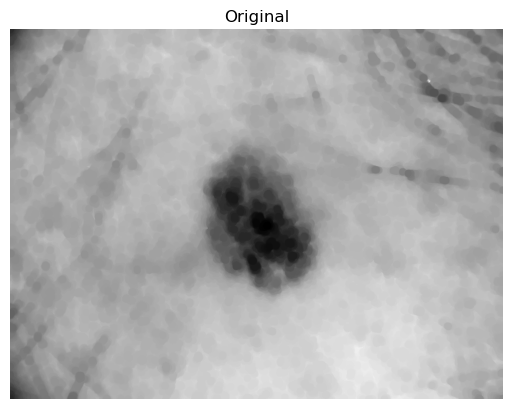

In [27]:
def remove_hairs_closing(imG):
    se = strel('disk', 15)
    sortie=morpho.closing(imG,se)
    return sortie
skinlesion_path = Working_directory + '/skinlesion'
pathi=skinlesion_path + "/IM_000180.jpg"
im=imread(pathi)
im=im[:,:,1]
im=remove_hairs_closing(im)
plt.imshow(im, cmap='gray')
plt.axis('off')
plt.title('Original') 
plt.show()

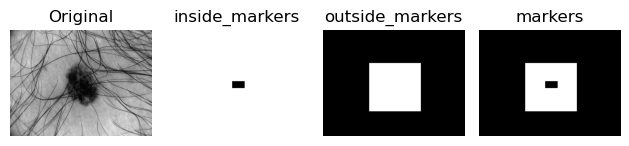

In [28]:
#Define markers
pathi=skinlesion_path + "/IM_000180.jpg"
im=imread(pathi)
im=im[:,:,2]
inside_markers = np.zeros_like(im)
inside_markers += 255
inside_markers[741:841,954:1134]=0

outside_markers = np.zeros_like(im)
outside_markers[478:1178,666:1411] = 255

# Combine the markers
markers = np.minimum(inside_markers,outside_markers)

# Plot the original image
plt.subplot(1, 4, 1)
plt.imshow(im, cmap='gray')
plt.axis('off')
plt.title('Original') 

# Plot the gradient after thresholding
plt.subplot(1, 4, 2)
plt.imshow(inside_markers, cmap='gray')
plt.axis('off')
plt.title('inside_markers')

# Plot the positions of the local minima
plt.subplot(1, 4, 3)
plt.imshow(outside_markers, cmap='gray')
plt.axis('off')
plt.title('outside_markers')

# Plot the contours of the watershed over the original image
plt.subplot(1, 4, 4)
plt.imshow(markers ,cmap='gray')
plt.axis('off')
plt.title('markers')

plt.tight_layout()
plt.show()

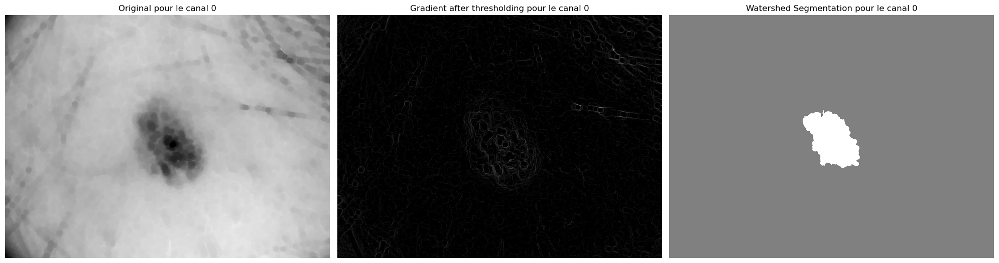

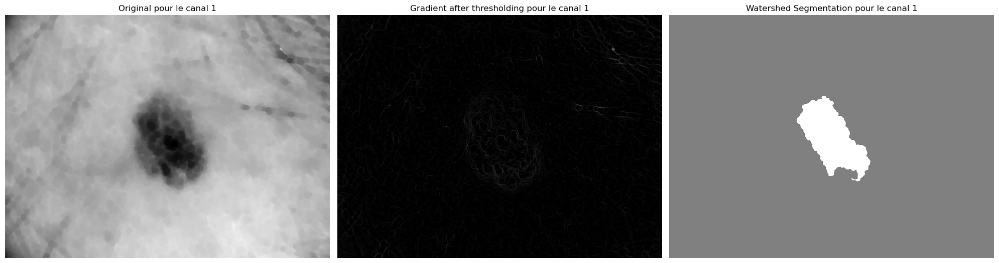

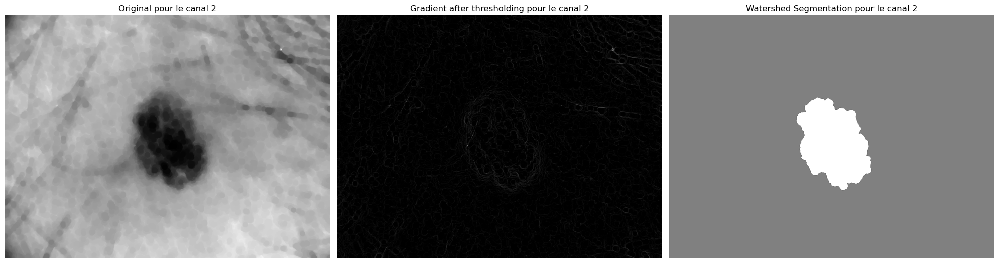

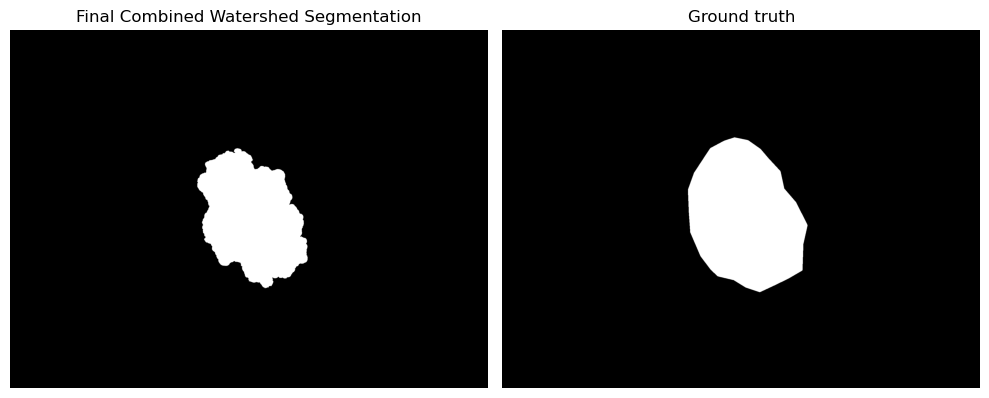

In [29]:
# Path to the image
pathi = skinlesion_path + "/IM_000180.jpg"
pathi_seg=skinlesion_path + "/IM_000180_Segmentation.png"
im_seg=imread(pathi_seg)
L = []  # List to store labels for each channel

for i in range(3):
    im = imread(pathi)  # Load the image
    im = im[:, :, i]  # Select the ith channel
    im = remove_hairs_closing(im)  # Apply hair removal

    se = strel('disk', 1)
    grad = morpho.dilation(im, se) - morpho.erosion(im, se)

    # Threshold the gradient image
    threshOtsu = threshold_otsu(im)
    thresh = 2  # Keeping it as is to maintain consistency

    I_intersection = np.minimum(grad, markers)
    im_reconstructed = morpho.reconstruction(markers, I_intersection, method='erosion')
    peak_mask = np.zeros_like(grad, dtype=bool)
    peak_mask[markers == 0] = True
    markers2, nbr = measure.label(peak_mask, return_num=True)

    labels = watershed(im_reconstructed, markers2, watershed_line=True)
    L.append(labels)  # Append each channel's label to L

    # Visualization for each channel (optional)
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 3, 1)
    plt.imshow(im, cmap='gray')
    plt.axis('off')
    plt.title(f'Original pour le canal {i}')

    plt.subplot(1, 3, 2)
    plt.imshow(grad, cmap='gray')
    plt.axis('off')
    plt.title(f'Gradient after thresholding pour le canal {i}')

    plt.subplot(1, 3, 3)
    plt.imshow(labels, cmap='gray')
    plt.axis('off')
    plt.title(f'Watershed Segmentation pour le canal {i}')

    plt.tight_layout()
    plt.show()

# Combine results by taking the max across all channels
Image_finale = np.maximum.reduce(L)

# Display the final combined image
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(Image_finale, cmap='gray')
plt.axis('off')
plt.title('Final Combined Watershed Segmentation')

plt.subplot(1, 2,2)
plt.imshow(im_seg, cmap='gray')
plt.axis('off')
plt.title('Ground truth')

plt.tight_layout()
plt.show()


In skin lesion case, it is common for a lesion to change intensity or even color, although it still represents a single entity. Instead of applying watershed segmentation directly on the grayscale level of the skin image—which could alter the true intensity and color information—we propose an alternative method. In this method, we apply watershed segmentation separately on each of the three color channels and then take the maximum result across all channels. This approach preserves the lesion's true intensity and color characteristics, providing a more accurate binary segmentation.

## Abdominal CT

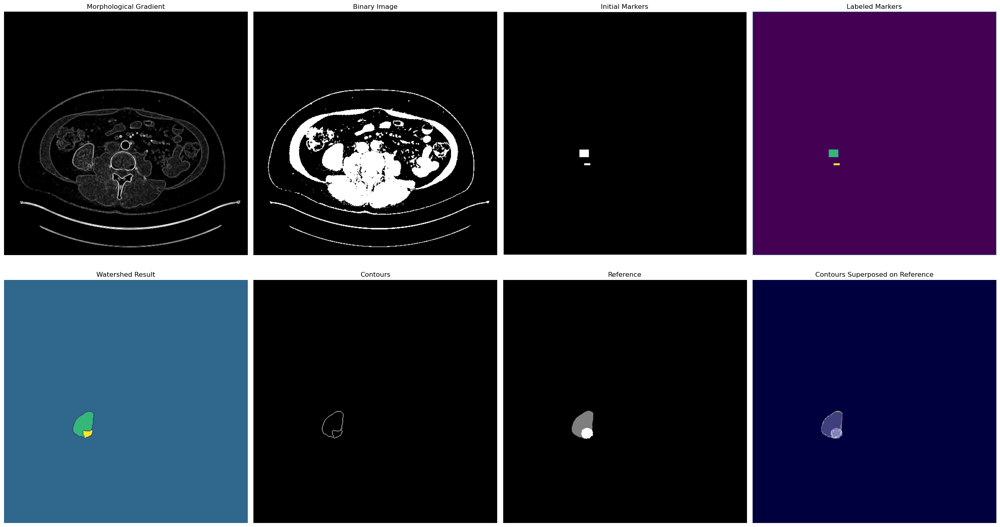

In [30]:
abdominalCT_path = Working_directory + '/abdominalCT'
pathi_seg = abdominalCT_path + "/CTs2-seg.tiff"
pathi = abdominalCT_path + "/CTs2.tiff"

# Reading the images
im_Seg = imread(pathi_seg)
im = imread(pathi)

# Normalize if needed
if (np.max(im) > 256):
    im = (im / 256).astype('uint8')

# Morphological gradient
se = morpho.disk(1)
grad = morpho.dilation(im, se) - morpho.erosion(im, se)
#grad=morpho.dilation(grad, se_2)

# Thresholding for binary image
threshOtsu = 20
binary = (im > threshOtsu) * 255

# Define initial markers
temp = np.zeros((binary.shape[0], binary.shape[1]), dtype=np.uint8)

for i in range(290, 306):
    for j in range(160, 180):
        temp[i, j] = 255


for i in range(319, 323):
    for j in range(170, 183):
        temp[i, j] = 255

init = np.minimum(binary, temp)


# Add a marker at the border of the image
init[:, 0] = 255
init[:, -1] = 255
init[0, :] = 255
init[-1, :] = 255

# Label markers
markers = ndi.label(init)[0]

# Watershed segmentation
labels = watershed(grad, markers, watershed_line=True)

# Create the contour visualization
segm = labels.copy()
segm[segm == 0] = 255
segm[segm != 255] = 0

# Plotting all figures in subplots
fig, axes = plt.subplots(2, 4, figsize=(25, 14))
axes = axes.ravel()  # Flatten the 2D array of axes for easy iteration

# Display images
axes[0].imshow(grad, cmap="gray")
axes[0].set_title("Morphological Gradient")
axes[0].axis('off')

axes[1].imshow(binary, cmap="gray")
axes[1].set_title("Binary Image")
axes[1].axis('off')

axes[2].imshow(init, cmap="gray")
axes[2].set_title("Initial Markers")
axes[2].axis('off')

axes[3].imshow(markers)
axes[3].set_title("Labeled Markers")
axes[3].axis('off')

axes[4].imshow(labels)
axes[4].set_title("Watershed Result")
axes[4].axis('off')

axes[5].imshow(segm, cmap="gray")
axes[5].set_title("Contours")
axes[5].axis('off')

axes[6].imshow(im_Seg, cmap="gray")
axes[6].set_title("Reference")
axes[6].axis('off')

# Superimpose contour on the reference image
axes[7].imshow(im_Seg, cmap="gray")
axes[7].imshow(segm, cmap="jet", alpha=0.5)  # Overlay with transparency
axes[7].set_title("Contours Superposed on Reference")
axes[7].axis('off')

# Hide any unused subplots
for i in range(8, len(axes)):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

In this case, we want to segment the kidney and a tumor that is attached to it. Therefore, we use two markers for the object: one for the kidney and one for the tumor. The results we obtained from the watershed method are acceptable. In this scenario, the watershed method is well-suited for segmentation, as it is one of the best techniques for separating two connected objects.

# Segmentation using deformable models

- parametric model, contour-based segmentation
- implicit model, using level sets (Chan & Vese), region-based segmentation


## Skin Lesion Segmentation

**Active countour**

With Active Contour (Snake) and Flood Fill:

This block uses two segmentation methods for a skin lesion image: the Active Contour (Snake) model and the Flood Fill method.
Result: The Active Contour model precisely follows the lesion’s border, adapting to its complex shape. The Flood Fill method segments the central region of the lesion based on a seed point and a tolerance threshold, providing an intensity-based segmentation alternative.

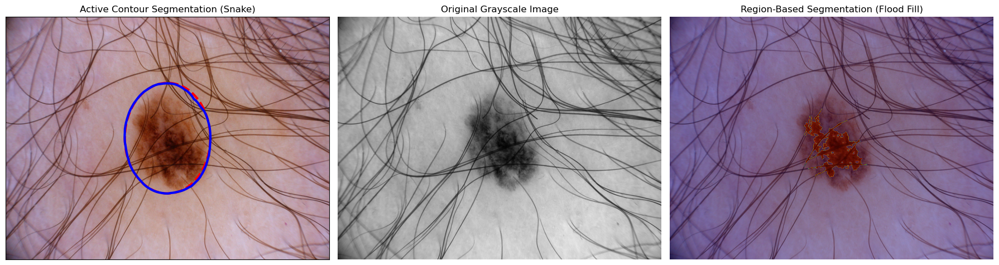

In [31]:
from skimage.color import rgb2gray
from skimage.segmentation import flood
pathi=skinlesion_path + "/IM_000180.jpg"
im_color=imread(pathi)
im_gray = rgb2gray(im_color)     #greyscale for segmentation
im_gray = img_as_float(im_gray)
image_center = (im_gray.shape[0] // 2, im_gray.shape[1] // 2) #center of the image

# Active contour segmentation (snake) using grayscale image
s = np.linspace(0, 2 * np.pi, 100)
r = image_center[0] + 350 * np.sin(s)  # Adjust radius
c = image_center[1] + 270 * np.cos(s)  # Adjust radius
init = np.array([r, c]).T
snake = active_contour(gaussian(im_gray, 0.1),
                       init, alpha=0.1, beta=10, w_edge=100, w_line=100, gamma=0.01)
im_smoothed = gaussian(im_gray, sigma=2)    #Gaussian smoothing for flood fill
# Define seed point near the center of the lesion
seed_point = (im_smoothed.shape[0] // 2, im_smoothed.shape[1] // 2)

# Perform region-based segmentation using flood fill (region growing)
tolerance = 0.1
mask_flood = flood(im_smoothed, seed_point, tolerance=tolerance)

# Display both segmentations: Active Contour and Region-Based Segmentation
fig, ax = plt.subplots(1, 3, figsize=(18, 6))
ax[0].imshow(im_color)
ax[0].plot(init[:, 1], init[:, 0], '--r', lw=3)  # Initial contour
ax[0].plot(snake[:, 1], snake[:, 0], '-b', lw=3)  # Final snake contour
ax[0].set_title("Active Contour Segmentation (Snake)")
ax[0].set_xticks([]), ax[0].set_yticks([])

# Original grayscale image
ax[1].imshow(im_gray, cmap="gray")
ax[1].set_title("Original Grayscale Image")
ax[1].axis("off")
ax[2].imshow(im_color)
ax[2].imshow(mask_flood, cmap="jet", alpha=0.3)
ax[2].set_title("Region-Based Segmentation (Flood Fill)")
ax[2].axis("off")
plt.tight_layout()
plt.show()


**Chan-Vese (Level Set)**

We use the Chan-Vese segmentation on a skin lesion image. After applying smoothing, a circular initial level set is used to guide the segmentation process.
Result: Chan-Vese effectively segments the inner region of the lesion, focusing on areas with similar intensity. The segmentation accurately captures the dark central area while penalizing outer regions to avoid including unwanted areas.

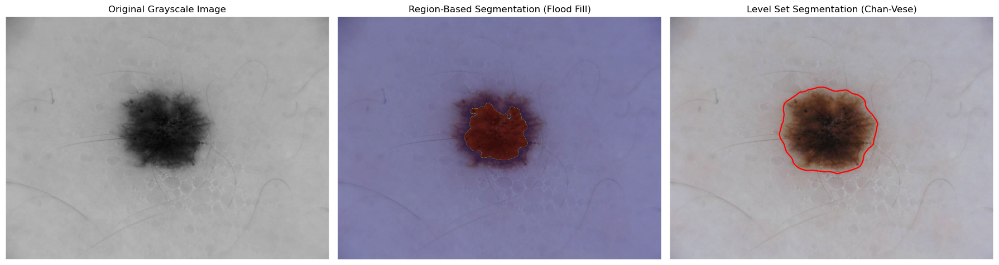

In [32]:
pathi=skinlesion_path + "/ISIC_0000001.jpg"
im_color=imread(pathi)
im_gray = rgb2gray(im_color)    #greyscale
im_gray = img_as_float(im_gray)
im_smoothed = gaussian(im_gray, sigma=5)        #Gaussian smoothing to focus on central region

initial_level_set = np.zeros(im_smoothed.shape)   #central region
center = (im_smoothed.shape[0] // 2, im_smoothed.shape[1] // 2)
radius = 30  # Small radius to initialize near the center
rr, cc = np.ogrid[:im_smoothed.shape[0], :im_smoothed.shape[1]]
circle = (rr - center[0])**2 + (cc - center[1])**2 < radius**2
initial_level_set[circle] = 1

#Chan-Vese segmentation
cv = chan_vese(
    im_smoothed,
    mu=0.5,                # Increased mu for smoother segmentation
    lambda1=0.5,           # Reduced to focus on internal region
    lambda2=2,             # Increased to penalize external regions
    tol=1e-3,
    max_num_iter=100,      # Reduced iterations
    dt=0.5,
    init_level_set=initial_level_set,  # Use the initialized small region in the center
    extended_output=True
)
fig, ax = plt.subplots(1, 3, figsize=(18, 6))

# Original image in grayscale
ax[0].imshow(im_gray, cmap="gray")
ax[0].set_title("Original Grayscale Image")
ax[0].axis("off")

# Region growing segmentation result
ax[1].imshow(im_color)
ax[1].imshow(flood(im_smoothed, center, tolerance=0.1), cmap="jet", alpha=0.3)  # Overlay mask with transparency
ax[1].set_title("Region-Based Segmentation (Flood Fill)")
ax[1].axis("off")

# Chan-Vese segmentation result with improved initialization and parameters
ax[2].imshow(im_color)
ax[2].contour(cv[0], [0.5], colors='red')  # Overlay the Chan-Vese segmentation contour
ax[2].set_title("Level Set Segmentation (Chan-Vese)")
ax[2].axis("off")

plt.tight_layout()
plt.show()

**Abdominal CT Segmentation with Chan-Vese (Level Set)**

We applied the Chan-Vese model to abdominal CT images, using a checkerboard initial level set to facilitate uniform segmentation. Chan-Vese effectively segments homogeneous abdominal regions based on intensity, producing an accurate segmentation mask that can be overlaid on the original image. The energy evolution is displayed throughout the iterations, demonstrating the model's convergence.

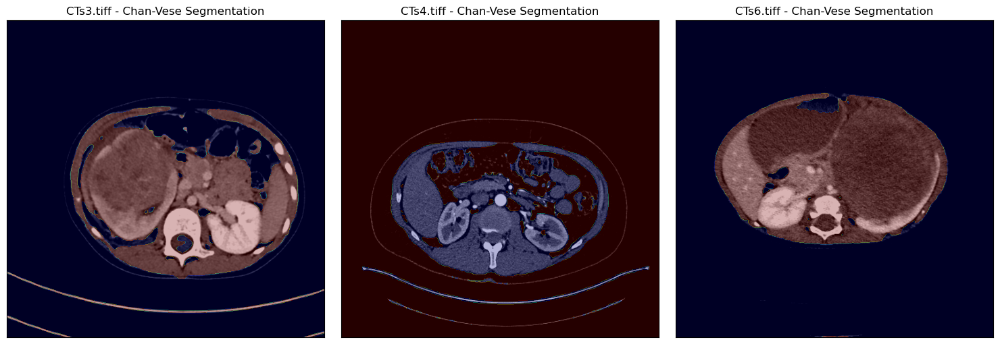

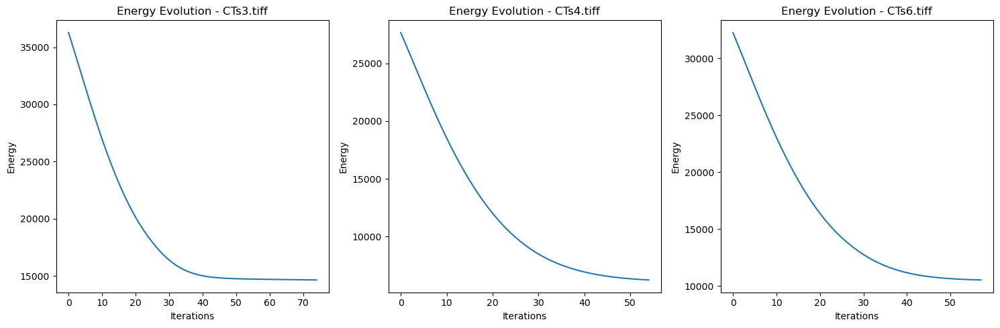

In [33]:
selected_files = ["CTs3.tiff", "CTs4.tiff", "CTs6.tiff"]
images = []
for filename in selected_files:
    filepath = os.path.join(abdominalCT_path, filename)
    im = imread(filepath)
    if len(im.shape) == 3:    #Convert to grayscale
        im = rgb2gray(im)
    im = img_as_float(im)
    # Apply Gaussian smoothing to reduce noise
    im_smoothed = gaussian(im, sigma=1)
   # Apply Chan-Vese segmentation
    cv_result = chan_vese(im_smoothed, mu=0.25, lambda1=1, lambda2=1, tol=1e-3,
                          max_num_iter=400, dt=0.5, init_level_set="checkerboard", extended_output=True)
    images.append((im, cv_result[0], cv_result[2]))  # Save original, segmented mask, and energy evolution

# Set up the grid for visualization
n_images = len(images)
cols = 3
rows = (n_images + cols - 1) // cols
fig, axs = plt.subplots(rows, cols, figsize=(15, 5 * rows))
# Reshape axs to be a 2D array even if only 1 row or column
axs = np.array(axs).reshape(rows, cols)

# Display each image with the segmentation mask and energy evolution
for i, (im, mask, energy) in enumerate(images):
    ax = axs[i // cols, i % cols]
    ax.imshow(im, cmap=plt.cm.gray)
    ax.imshow(mask, cmap="jet", alpha=0.3)  # Overlay the mask with transparency
    ax.set_title(f"{selected_files[i]} - Chan-Vese Segmentation")
    ax.set_xticks([]), ax.set_yticks([])

# Remove empty axes
for j in range(i + 1, rows * cols):
    fig.delaxes(axs[j // cols, j % cols])
#plots

plt.tight_layout()
plt.show()
fig, ax = plt.subplots(1, len(images), figsize=(15, 5))
for i, (_, _, energy) in enumerate(images):
    ax[i].plot(energy)
    ax[i].set_title(f"Energy Evolution - {selected_files[i]}")
    ax[i].set_xlabel("Iterations")
    ax[i].set_ylabel("Energy")

plt.tight_layout()
plt.show()

**Brain MRI Segmentation with Active Contour (Snake)**

We applied the Active Contour model to brain MRI images, using an initial ovoid contour centered on the brain. The Snake model adapts to the contours of the brain in the MRI images, outlining the main brain structure. The configured parameters enable a well-defined contour that closely follows the detailed shape of the brain.

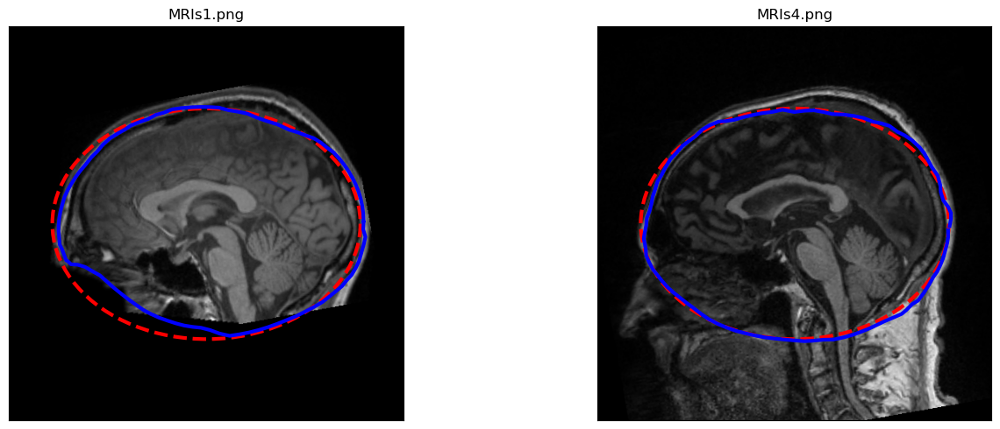

In [34]:

selected_mri_files = ["MRIs1.png", "MRIs4.png"]
mri_images = []
for filename in selected_mri_files:                   #loop for reading the images
    filepath = os.path.join(brainMRI_path, filename)
    im = imread(filepath)
    if len(im.shape) == 3:
        im = rgb2gray(im)

    image_center = (im.shape[0] // 2, im.shape[1] // 2)   #initial contour for the snake
    s = np.linspace(0, 2 * np.pi, 100)
    r = image_center[0] + 150 * np.sin(s)
    c = image_center[1] + 200 * np.cos(s)
    init = np.array([r, c]).T
    snake = active_contour(gaussian(im, 0.1),    #active contourn of the snake
                           init, alpha=0.1, beta=6,
                           w_edge=90, w_line=110, gamma=0.05)
    mri_images.append((im, init, snake))
n_images = len(mri_images)
cols = 2
rows = (n_images + cols - 1) // cols

fig, axs = plt.subplots(rows, cols, figsize=(15, 5 * rows))
if n_images == 1:
    axs = np.array([[axs]])  # Convert single subplot to 2D array
elif n_images == 2:
    axs = axs.reshape(1, -1)  # Convert row of subplots to 2D array

for i, (im, init, snake) in enumerate(mri_images):    #initial and final contours
    ax = axs[i // cols, i % cols]
    ax.imshow(im, cmap=plt.cm.gray)
    ax.plot(init[:, 1], init[:, 0], '--r', lw=3)  # Initial contour
    ax.plot(snake[:, 1], snake[:, 0], '-b', lw=3)  # Final contour
    ax.set_title(selected_mri_files[i])
    ax.set_xticks([]), ax.set_yticks([])

# Remove any empty axes
for j in range(i + 1, rows * cols):
    fig.delaxes(axs[j // cols, j % cols])
plt.tight_layout()
plt.show()

**Brain MRI Segmentation with Chan-Vese and Region-Based Segmentation**

We applied the Chan-Vese model and region-based segmentation (flood fill) to brain MRI images. The Chan-Vese method used a checkerboard initial level set to segment regions of similar intensity, with an energy plot showing model convergence. The flood fill segmentation captured central regions based on intensity, using a seed point and tolerance threshold. This combination provided effective segmentation of brain structures, with Chan-Vese focusing on complex regions and flood fill highlighting areas of intensity continuity.

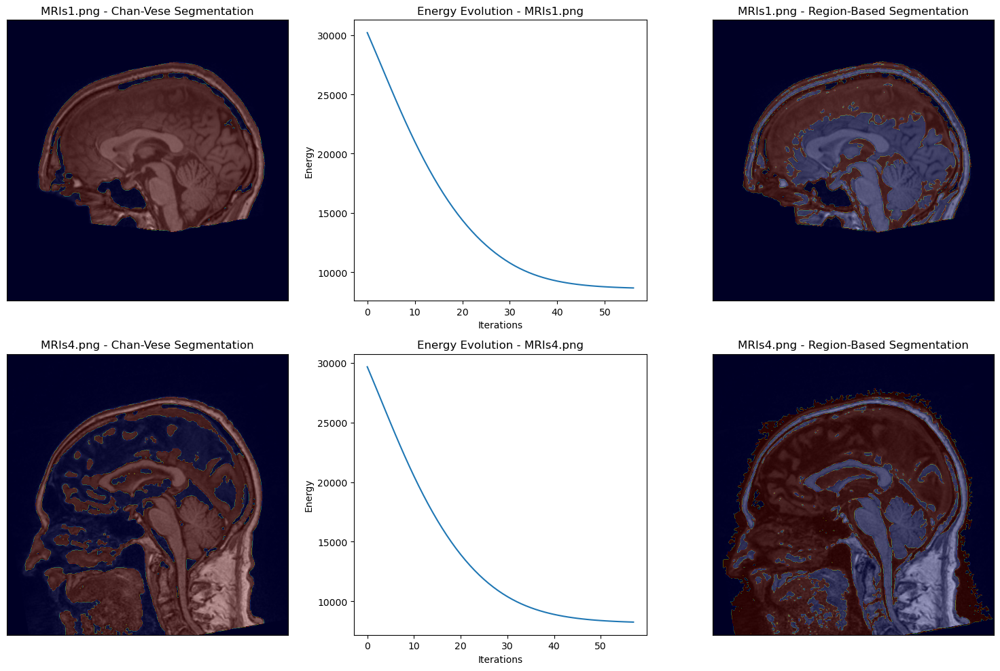

In [35]:
selected_mri_files = ["MRIs1.png", "MRIs4.png"]
mri_images = []
for filename in selected_mri_files:
    filepath = os.path.join(brainMRI_path, filename)
    im = imread(filepath)
    if len(im.shape) == 3:        #Convert to grayscale
        im = rgb2gray(im)
    im = img_as_float(im)  # Convert to float for Chan-Vese
    im_smoothed = gaussian(im, sigma=1)    # Apply Gaussian smoothing to reduce noise
    im_smoothed = gaussian(im, sigma=1)

    #Chan-Vese segmentation
    cv_result = chan_vese(im_smoothed, mu=0.25, lambda1=1, lambda2=1, tol=1e-3,
                          max_num_iter=400, dt=0.5, init_level_set="checkerboard", extended_output=True)

    #Region-based segmentation using flood fill (region growing)
    seed_point = (im_smoothed.shape[0] // 2, im_smoothed.shape[1] // 2)
    tolerance = 0.1                 # Adjust tolerance to control growth
    region_mask = flood(im_smoothed, seed_point, tolerance=tolerance)
    mri_images.append((im, cv_result[0], cv_result[2], region_mask))
n_images = len(mri_images)        #visualisation
cols = 3
rows = n_images

fig, axs = plt.subplots(rows, cols, figsize=(15, 5 * rows))
if rows == 1:
    axs = [axs]

# Display each MRI image with Chan-Vese and region-based segmentation results
for i, (im, cv_mask, energy, region_mask) in enumerate(mri_images):
    # Original Image with Chan-Vese Segmentation
    axs[i][0].imshow(im, cmap=plt.cm.gray)
    axs[i][0].imshow(cv_mask, cmap="jet", alpha=0.3)  # Overlay Chan-Vese mask
    axs[i][0].set_title(f"{selected_mri_files[i]} - Chan-Vese Segmentation")
    axs[i][0].set_xticks([]), axs[i][0].set_yticks([])

    # Energy Evolution Plot for Chan-Vese
    axs[i][1].plot(energy)
    axs[i][1].set_title(f"Energy Evolution - {selected_mri_files[i]}")
    axs[i][1].set_xlabel("Iterations")
    axs[i][1].set_ylabel("Energy")

    # Original Image with Region-Based Segmentation
    axs[i][2].imshow(im, cmap=plt.cm.gray)
    axs[i][2].imshow(region_mask, cmap="jet", alpha=0.3)  # Overlay region-based mask
    axs[i][2].set_title(f"{selected_mri_files[i]} - Region-Based Segmentation")
    axs[i][2].set_xticks([]), axs[i][2].set_yticks([])

plt.tight_layout()
plt.show()

**Segmentation using Deformable Models: Parametric and Implicit Approaches**

The **parametric model (Active Contour/Snake)** effectively captured well-defined boundaries in abdominal CT and brain MRI images, with the initial contour adapting to the object's edges through optimized parameters. This approach provided precise contouring in images where the structure had clear, sharp boundaries.

The **implicit model (Chan-Vese)**, based on level sets, was applied to skin lesions, abdominal CT scans, and brain MRIs, targeting regions of similar intensity. Chan-Vese segmentation performed well in images with less distinct edges, allowing for segmentation based on intensity continuity rather than boundary gradients. The model converged reliably, as indicated by energy plots, providing accurate region-based segmentation.
The **Active Contour model** excelled in cases with well-defined edges, while **Chan-Vese** was more suited to regions with intensity homogeneity.
The most challenging part was setting the parameters for each model and dataset to achieve optimal results, as small adjustments in parameters (such as `alpha`, `beta`, and `w_edge` for Active Contour, or `mu`, `lambda1`, and `lambda2` for Chan-Vese) could significantly impact segmentation accuracy. Additionally, finding appropriate initialization shapes and managing image noise required frequent adjustments and refinements. Overall, this dual approach proved flexible and effective, though sensitive to parameterization and initialization settings.

# Segmentation of an image sequence

(256, 256, 11, 20)


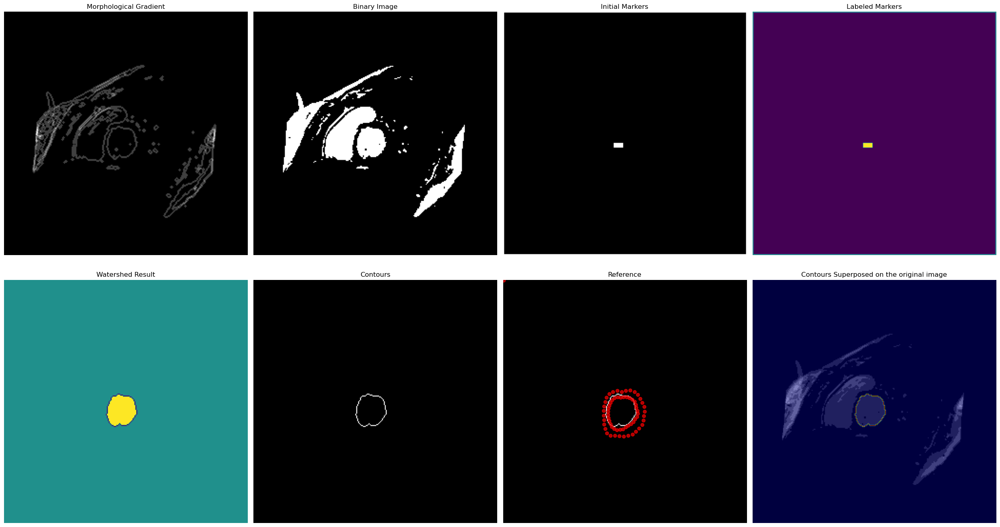

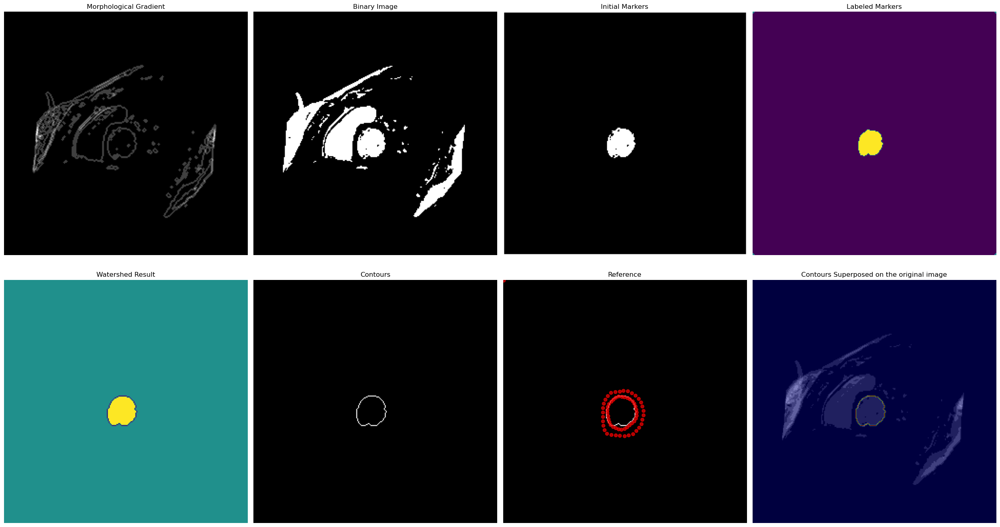

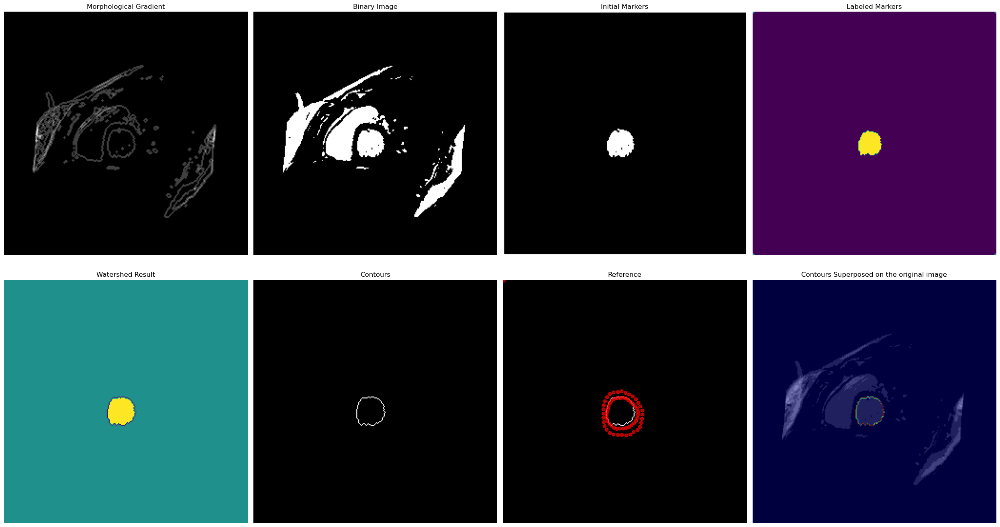

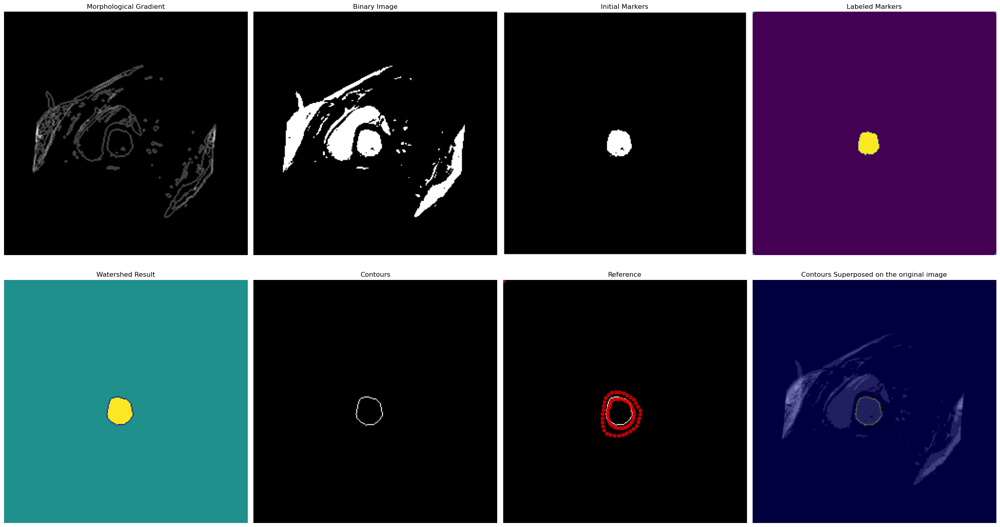

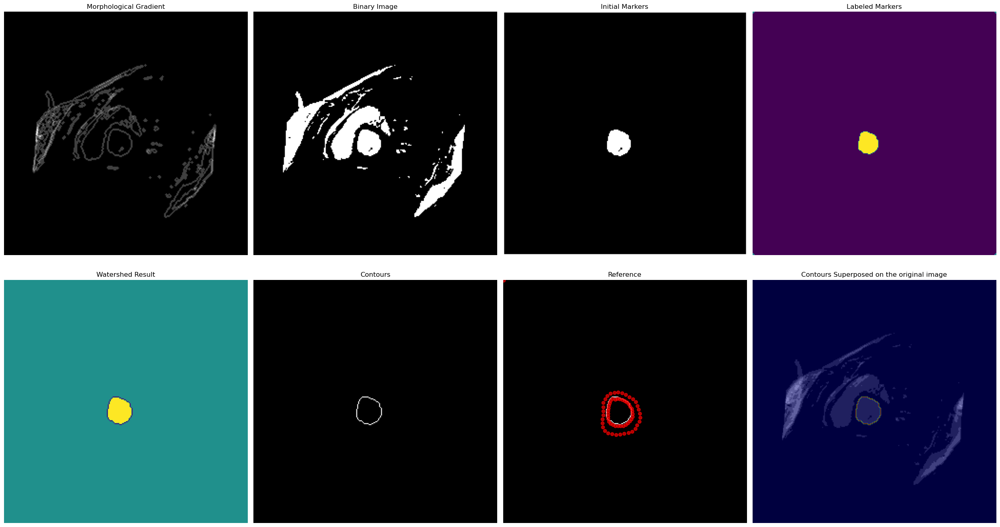

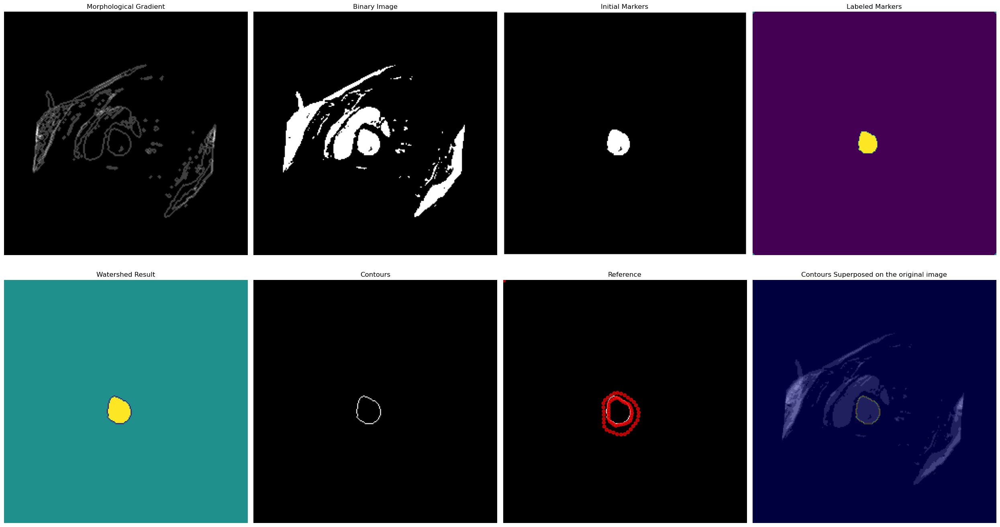

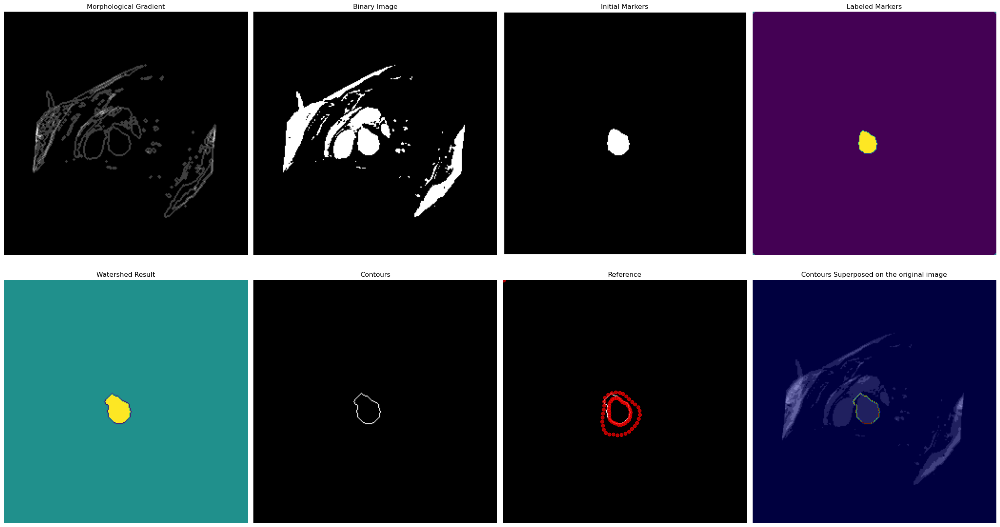

In [36]:
data=loadmat(MRIheart_path + 'dataMRIheart.mat')
data=data['data']
seg=loadmat(MRIheart_path + 'segMRIheart.mat')
seg=seg['seg']
print(data.shape)
# Reading the images
# Define initial markers
im = data[:,:,2,0]

        # Morphological gradient
threshOtsu = threshold_otsu(im)
binary = (im > threshOtsu) * 255
temp = np.zeros((im.shape[0], im.shape[1]), dtype=np.uint8)
for i in range(138,143):
 for j in range(116,126):
        temp[i,j]=255

init = np.minimum(binary, temp)

                # Add a marker at the border of the image
init[:, 0] = 255
init[:, -1] = 255
init[0, :] = 255
init[-1, :] = 255
markers = ndi.label(init)[0]

for k in range (0,7) :
        im = data[:,:,2,k]

        # Normalize if needed
        if (np.max(im) > 256):
            im = (im / 256).astype('uint8')
        # Morphological gradient
        #grad=morpho.dilation(grad, se_2)
                # Thresholding for binary image
        threshOtsu = threshold_otsu(im)
        binary = (im > threshOtsu) * 255
        se = morpho.disk(1)
        grad = morpho.dilation(im, se) - morpho.erosion(im, se)
        # Label markers
        # Watershed segmentation
        labels = watershed(grad, markers, watershed_line=True)

        # Create the contour visualization
        segm = labels.copy()
        segm[segm == 0] = 255
        segm[segm != 255] = 0

        # Plotting all figures in subplots
        fig, axes = plt.subplots(2, 4, figsize=(25, 14))
        axes = axes.ravel()  # Flatten the 2D array of axes for easy iteration

        # Display images
        axes[0].imshow(grad, cmap="gray")
        axes[0].set_title("Morphological Gradient")
        axes[0].axis('off')

        axes[1].imshow(binary, cmap="gray")
        axes[1].set_title("Binary Image")
        axes[1].axis('off')

        axes[2].imshow(init, cmap="gray")
        axes[2].set_title("Initial Markers")
        axes[2].axis('off')

        axes[3].imshow(markers)
        axes[3].set_title("Labeled Markers")
        axes[3].axis('off')

        axes[4].imshow(labels)
        axes[4].set_title("Watershed Result")
        axes[4].axis('off')

        axes[5].imshow(segm, cmap="gray")
        axes[5].set_title("Contours")
        axes[5].axis('off')

        axes[6].imshow(segm, cmap="gray")
        axes[6].scatter(seg[2,k][:,0], seg[2,k][:,1], c='r',alpha=0.7) 
        axes[6].set_title("Reference")
        axes[6].axis('off')

        # Superimpose contour on the reference image
        axes[7].imshow(im, cmap="gray")
        axes[7].imshow(segm, cmap="jet", alpha=0.5)  # Overlay with transparency  # Overlay with transparency
        axes[7].set_title("Contours Superposed on the original image")
        axes[7].axis('off')

        # Hide any unused subplots
        for i in range(8, len(axes)):
            axes[i].axis('off')

        plt.tight_layout()
        plt.show()
        label_to_extract = 2  # Le label que vous souhaitez extraire

        # Créer une image noire de la même taille que 'labels'
        binary_image = np.zeros_like(labels, dtype=np.uint8)

        # Mettre la valeur 255 aux coordonnées correspondant au deuxième label
        binary_image[labels == label_to_extract] = 255
        temp=binary_image
        im = data[:,:,2,k+1]
        # Normalize if needed
        if (np.max(im) > 256):
            im = (im / 256).astype('uint8')
        # Morphological gradient
        #grad=morpho.dilation(grad, se_2)
                # Thresholding for binary image
        threshOtsu = threshold_otsu(im)
        binary = (im > threshOtsu) * 255
        init = np.minimum(binary, temp)

                # Add a marker at the border of the image
        init[:, 0] = 255
        init[:, -1] = 255
        init[0, :] = 255
        init[-1, :] = 255
        markers = ndi.label(init)[0]
        se=morpho.disk(2)
        markers=morpho.closing(markers,se)
        markers=morpho.erosion(markers,se)

The results we found are nothing... but WONDERFUL. Let's explain how we implemented our method. The idea is to update the markers based on the labels found in the previous iteration. Before doing that, we apply a closing operation to fill the holes in the labels (which will serve as markers for the next iteration). To ensure that our marker is completely contained within the left ventricle in the next iteration, we apply an erosion to reduce the size of the marker.

This method works well up to the 7th iteration. However, in the 8th image, the left ventricle appears to be connected to another part of the heart, causing the segmentation to lose not only precision but to become a complete disaster, segmenting entirely unrelated structures.

Additionally, this method may not work in other cases due to the movement of the heart. Here, we apply an erosion using a structuring element (SE) of size 2 to reduce the size of the marker. However, it may happen that in a certain iteration, the left ventricle becomes so small that the marker is no longer completely contained within the target (the left ventricle).